# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [7]:

# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [8]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

In [ ]:
um_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0876074962615965, discriminator loss: 0.28918633591756226


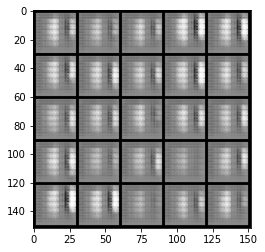

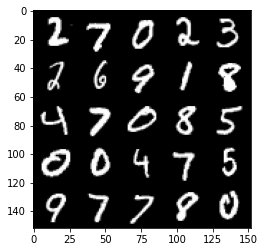

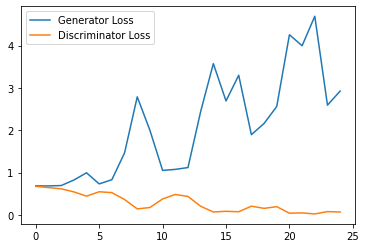

Step 1000: Generator loss: 4.278399514198303, discriminator loss: 0.055677082185633484


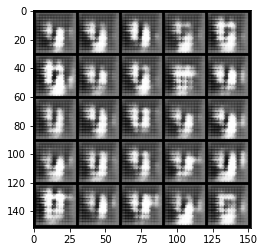

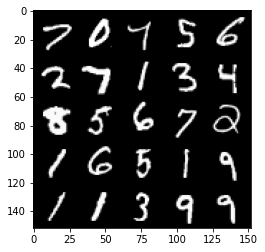

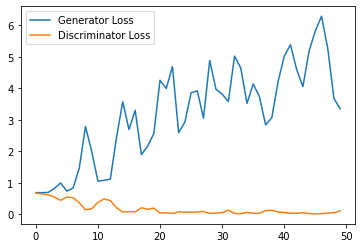

Step 1500: Generator loss: 4.091744045734406, discriminator loss: 0.07509456047043205


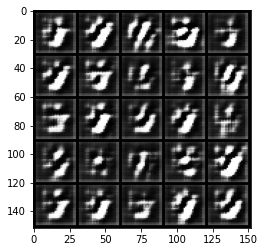

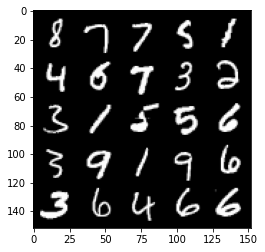

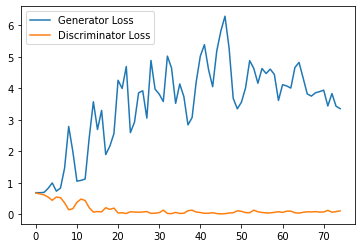

Step 2000: Generator loss: 3.1394717185497285, discriminator loss: 0.1388471469655633


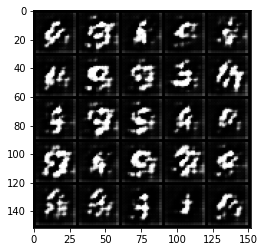

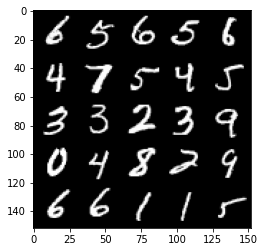

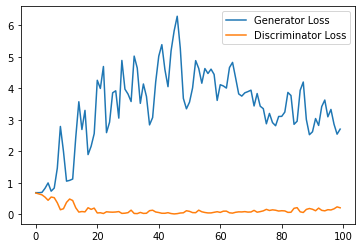

Step 2500: Generator loss: 2.6814200110435484, discriminator loss: 0.2439725376665592


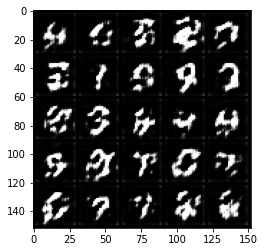

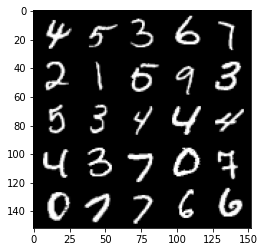

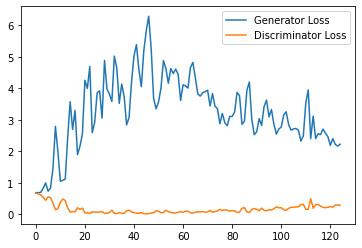

Step 3000: Generator loss: 2.103101589679718, discriminator loss: 0.32291741800308227


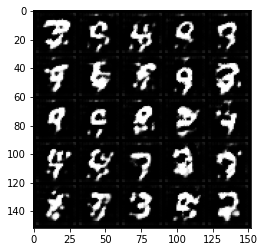

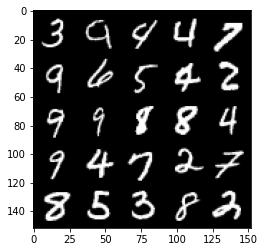

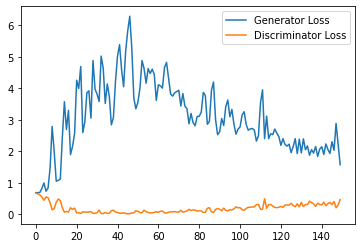

Step 3500: Generator loss: 1.8811151733398437, discriminator loss: 0.3307127044200897


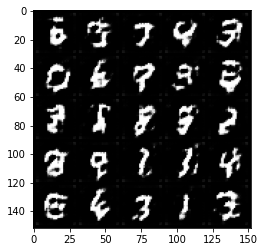

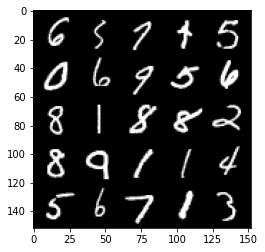

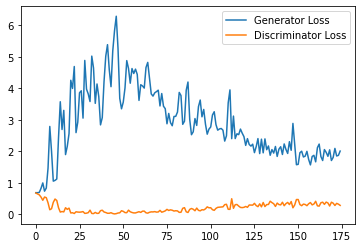

Step 4000: Generator loss: 1.8909317033290862, discriminator loss: 0.3415521293282509


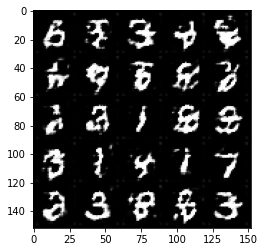

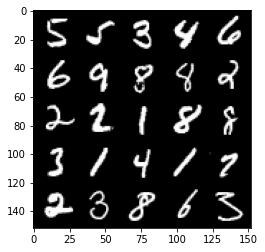

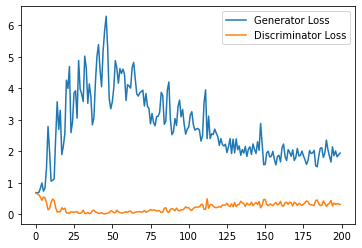

Step 4500: Generator loss: 1.8199397418498993, discriminator loss: 0.36930971002578733


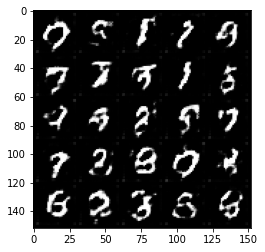

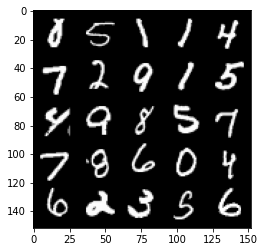

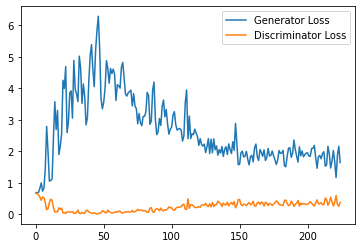

Step 5000: Generator loss: 1.745432570695877, discriminator loss: 0.4081262354552746


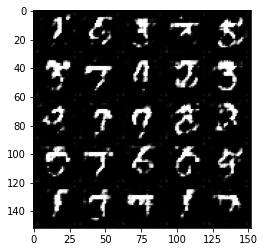

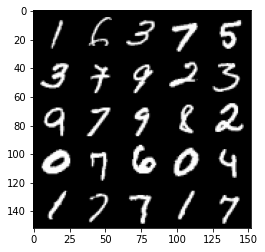

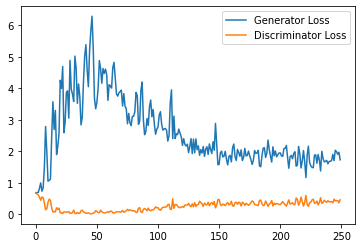

Step 5500: Generator loss: 1.6778394423723222, discriminator loss: 0.41253277760744095


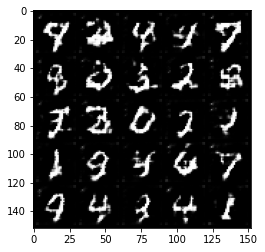

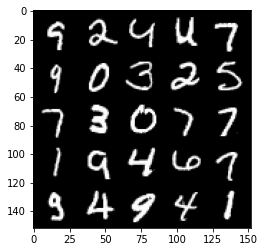

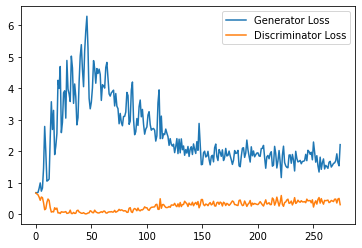

Step 6000: Generator loss: 1.5750628218650817, discriminator loss: 0.4437525809407234


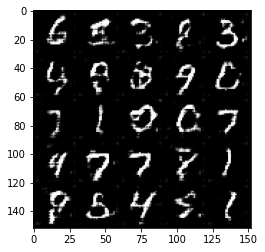

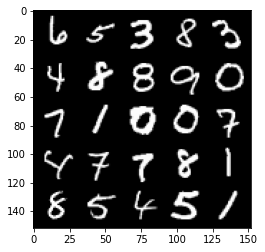

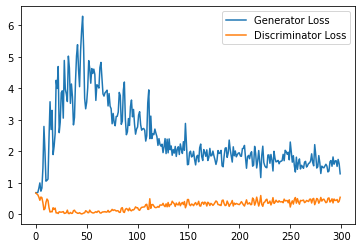

Step 6500: Generator loss: 1.498640335917473, discriminator loss: 0.45934221398830416


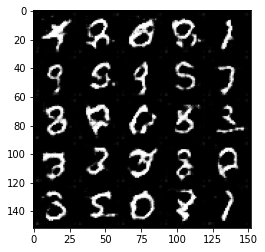

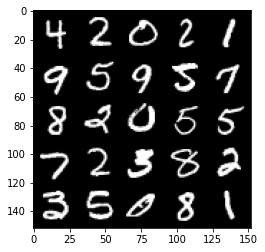

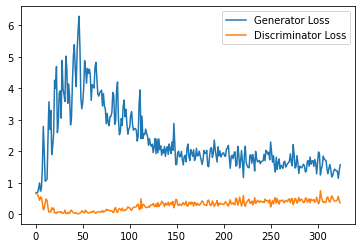

Step 7000: Generator loss: 1.3862932422161103, discriminator loss: 0.478163145840168


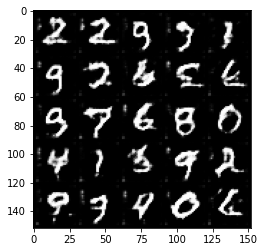

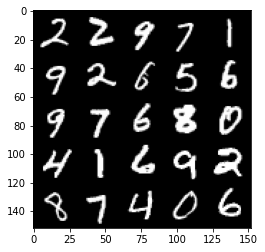

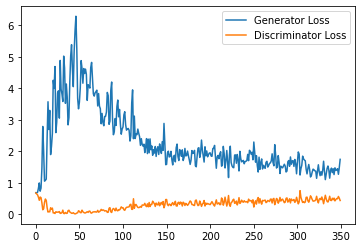

Step 7500: Generator loss: 1.4595203503370284, discriminator loss: 0.4950706915855408


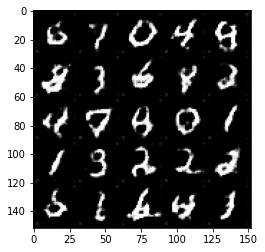

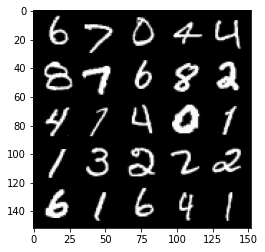

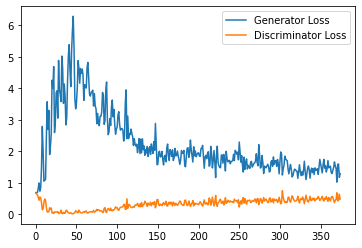

Step 8000: Generator loss: 1.3757867064476013, discriminator loss: 0.503478133380413


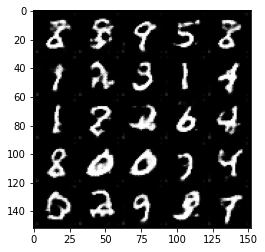

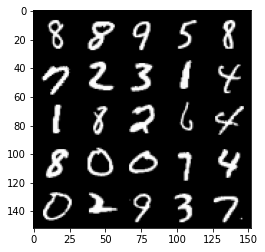

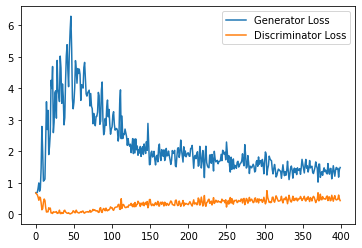

Step 8500: Generator loss: 1.3013618487119674, discriminator loss: 0.5273205256462097


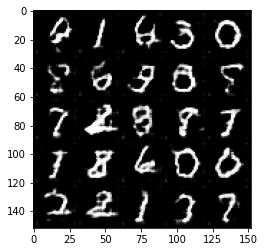

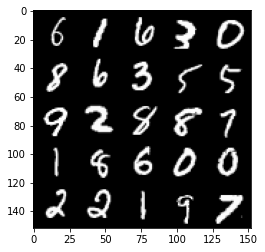

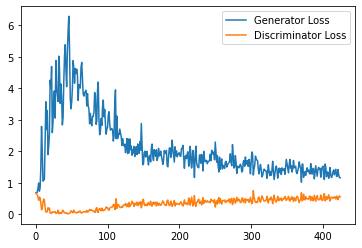

Step 9000: Generator loss: 1.2553402025699616, discriminator loss: 0.5477738020420074


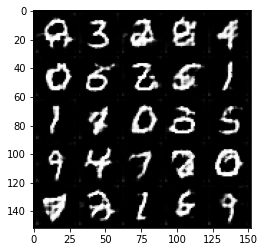

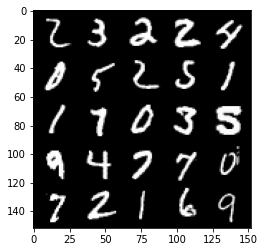

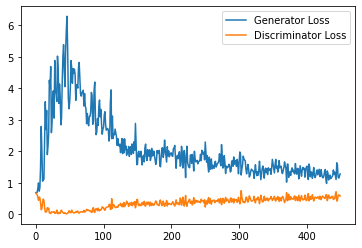

Step 9500: Generator loss: 1.3365371429920196, discriminator loss: 0.5390139293074608


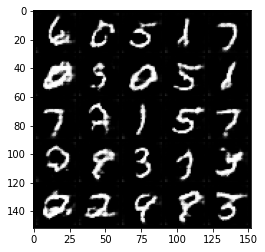

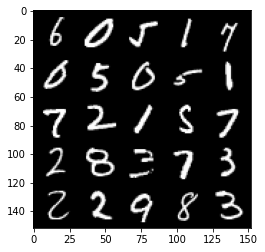

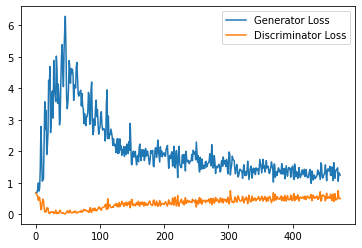

Step 10000: Generator loss: 1.1761235109567643, discriminator loss: 0.5468628892898559


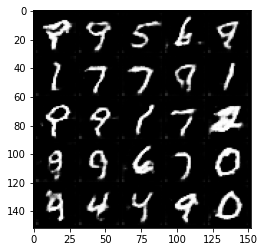

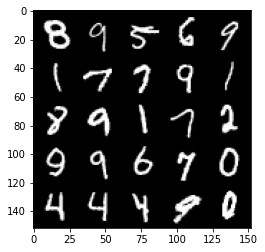

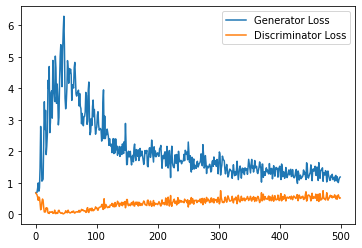

Step 10500: Generator loss: 1.1305100461244584, discriminator loss: 0.566493031680584


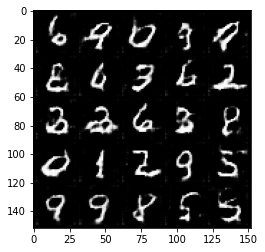

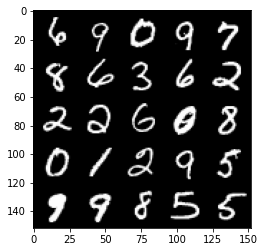

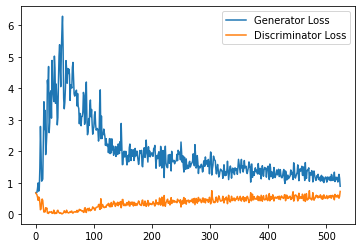

Step 11000: Generator loss: 1.1688606696128845, discriminator loss: 0.5577465091347694


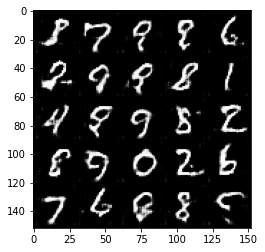

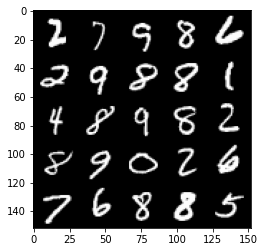

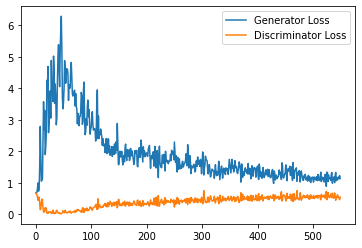

Step 11500: Generator loss: 1.1708084149360656, discriminator loss: 0.5747719448208809


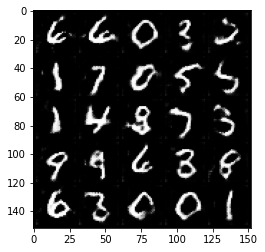

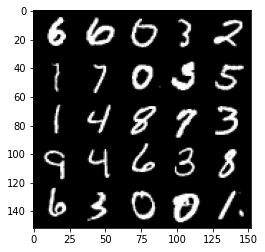

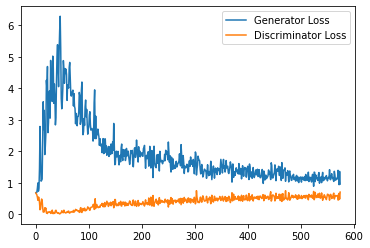

Step 12000: Generator loss: 1.1547548204660416, discriminator loss: 0.5707637084126472


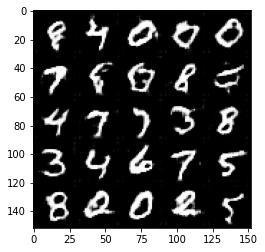

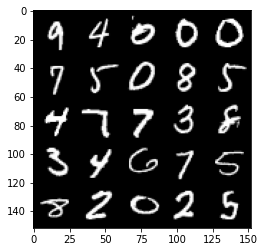

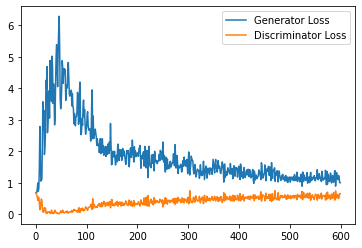

Step 12500: Generator loss: 1.074052942752838, discriminator loss: 0.5677187557816505


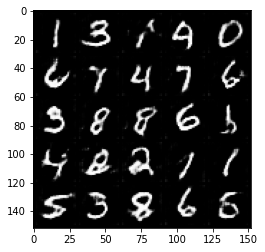

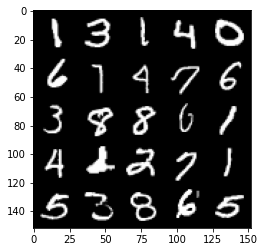

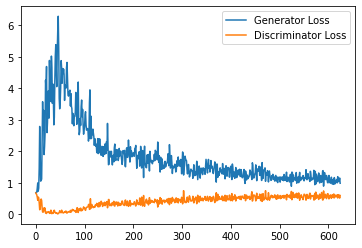

Step 13000: Generator loss: 1.0894035605192185, discriminator loss: 0.5727469837069511


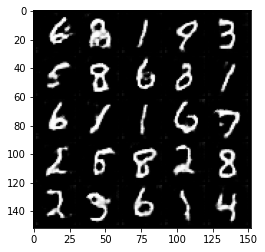

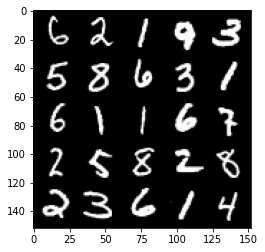

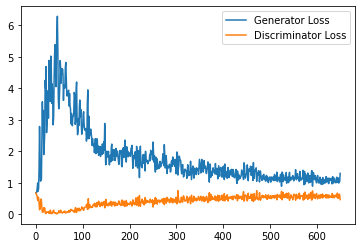

Step 13500: Generator loss: 1.0821471016407014, discriminator loss: 0.5806062735319137


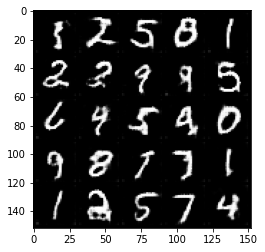

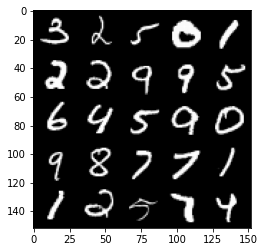

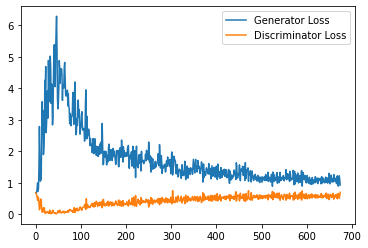

Step 14000: Generator loss: 1.072421469449997, discriminator loss: 0.5747805660963059


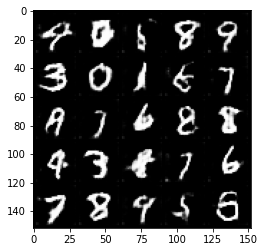

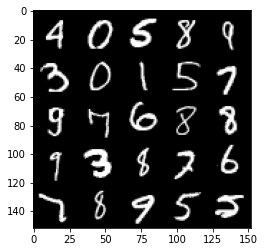

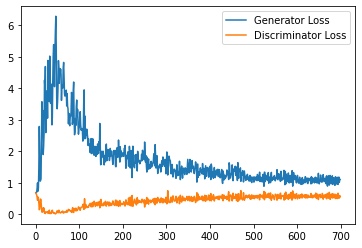

Step 14500: Generator loss: 1.0757340947389602, discriminator loss: 0.5859492642879486


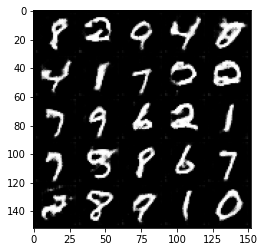

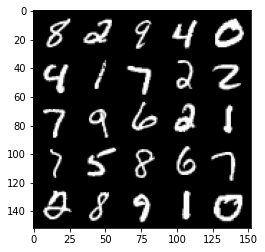

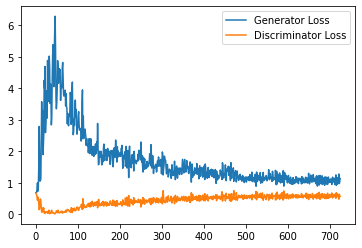

Step 15000: Generator loss: 1.0846292415857315, discriminator loss: 0.5797936282753945


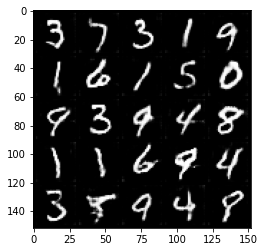

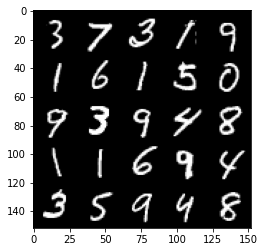

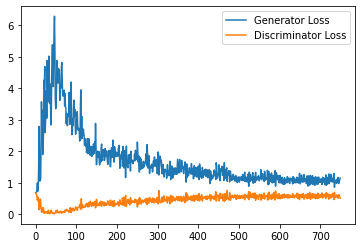

Step 15500: Generator loss: 1.0251073459386826, discriminator loss: 0.592044139623642


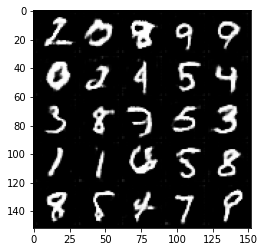

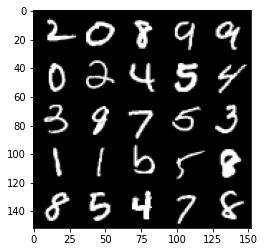

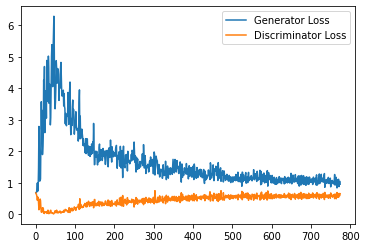

Step 16000: Generator loss: 1.072500761628151, discriminator loss: 0.5870253226161003


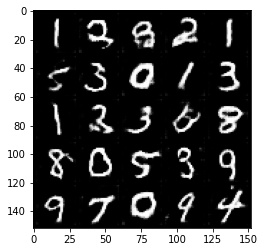

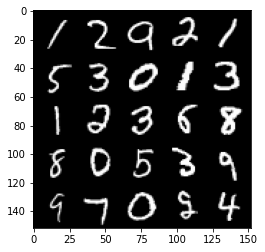

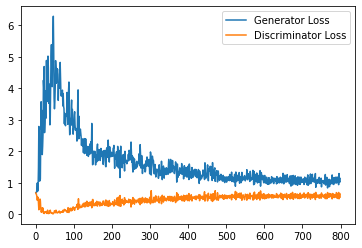

Step 16500: Generator loss: 1.0531220132112502, discriminator loss: 0.5817450068593025


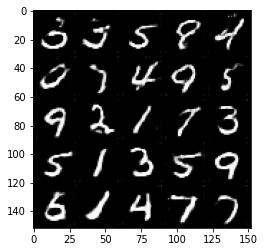

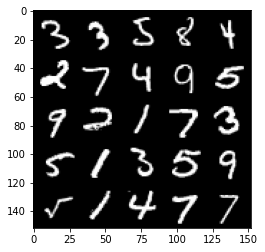

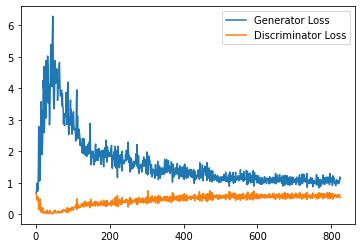

Step 17000: Generator loss: 1.0883411022424698, discriminator loss: 0.5813820394873619


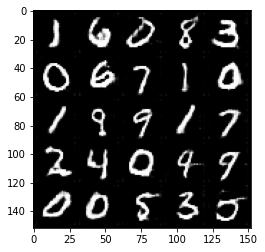

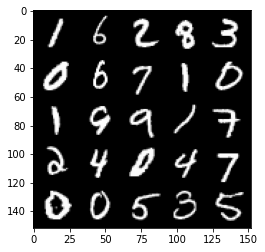

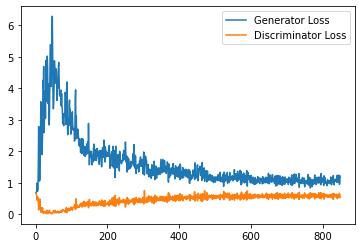

Step 17500: Generator loss: 1.0739895142316818, discriminator loss: 0.587795803964138


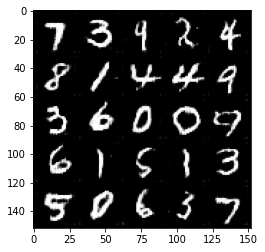

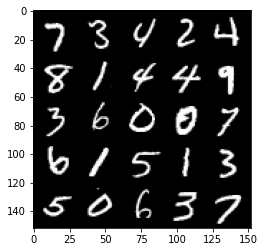

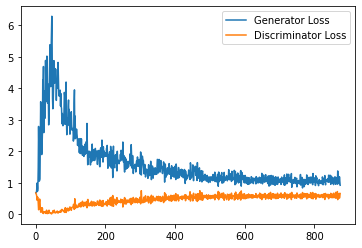

Step 18000: Generator loss: 1.03413727581501, discriminator loss: 0.5876839455962181


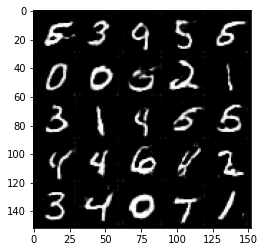

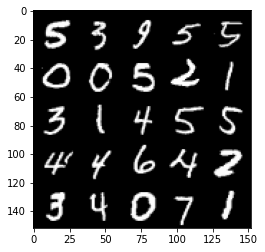

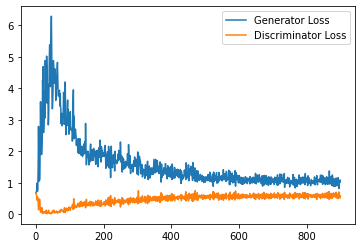

Step 18500: Generator loss: 1.011729035258293, discriminator loss: 0.5954289055466652


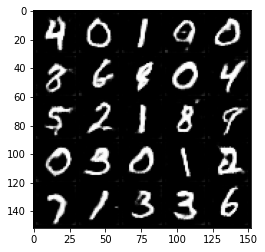

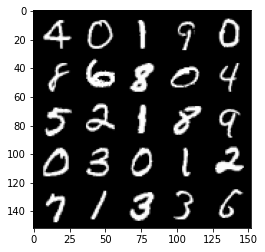

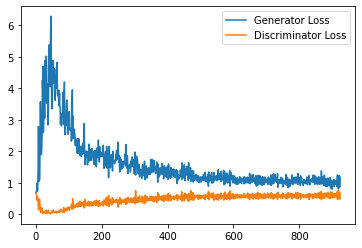

Step 19000: Generator loss: 1.0240140507221223, discriminator loss: 0.5889288174510002


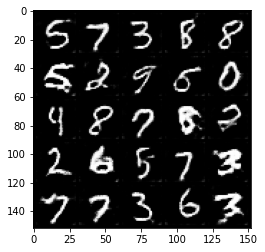

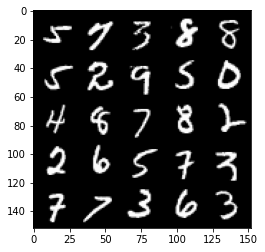

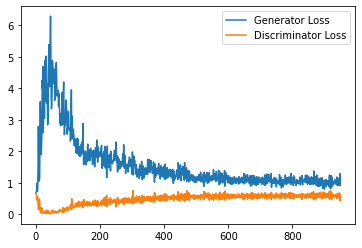

Step 19500: Generator loss: 1.0132868415117264, discriminator loss: 0.5983161048889161


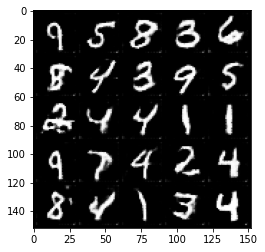

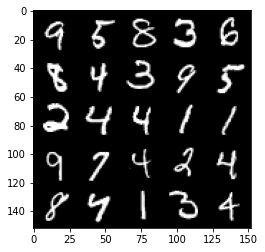

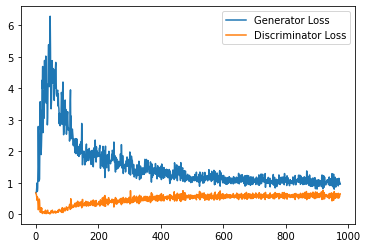

Step 20000: Generator loss: 1.0286472814083099, discriminator loss: 0.589542458474636


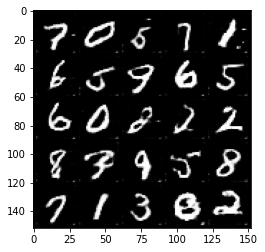

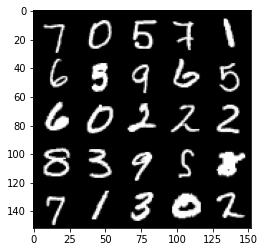

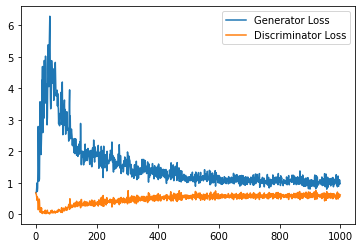

Step 20500: Generator loss: 1.0168833413124085, discriminator loss: 0.5881355308294296


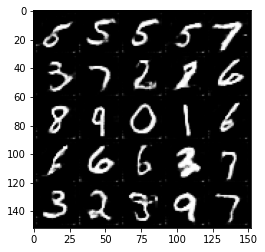

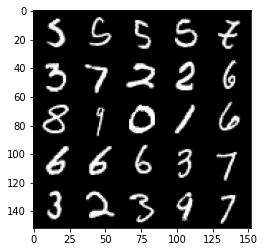

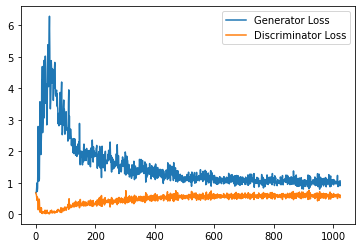

Step 21000: Generator loss: 1.0076264160871506, discriminator loss: 0.5945190083384514


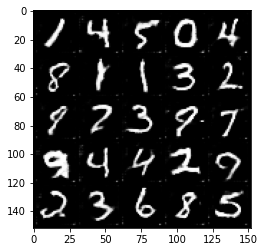

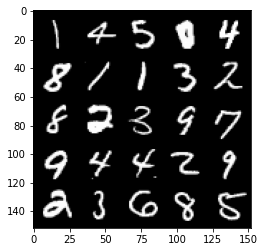

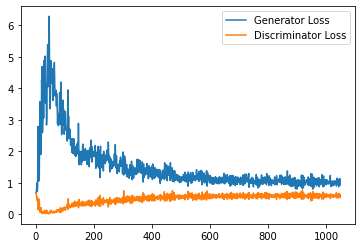

Step 21500: Generator loss: 1.0179658871889115, discriminator loss: 0.5925608834624291


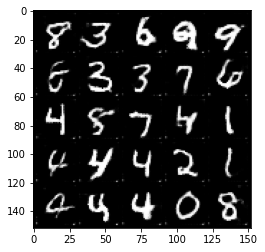

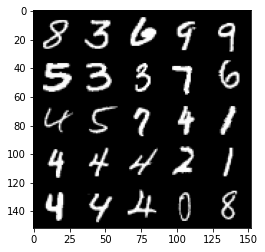

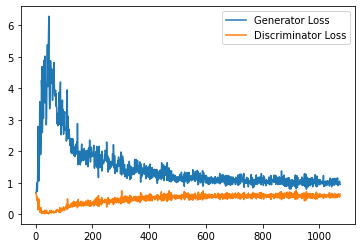

Step 22000: Generator loss: 0.9985354367494583, discriminator loss: 0.5894624431729316


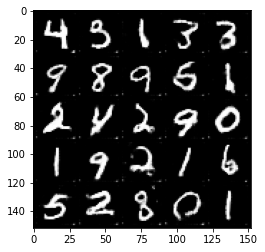

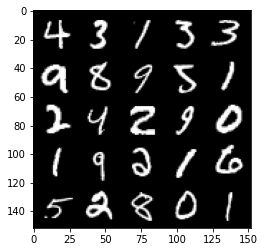

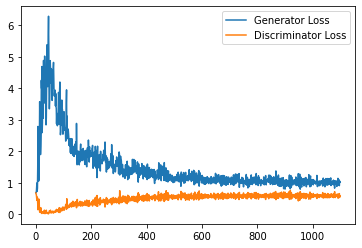

Step 22500: Generator loss: 1.0336151267290115, discriminator loss: 0.5866162098050117


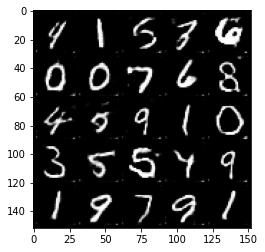

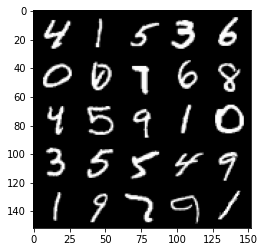

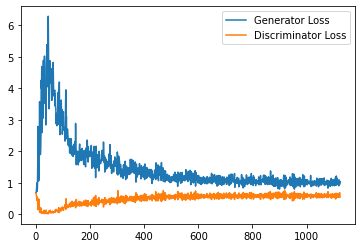

Step 23000: Generator loss: 1.0192884520292282, discriminator loss: 0.5888861243128777


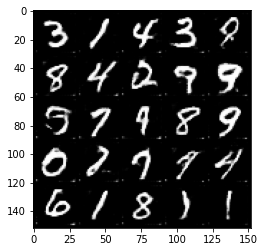

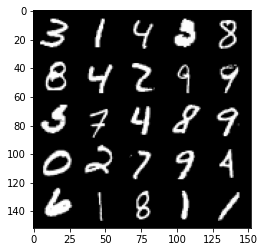

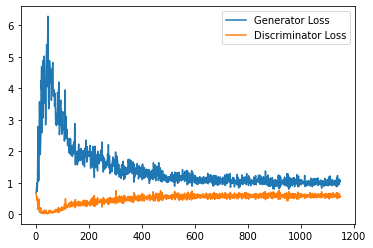

Step 23500: Generator loss: 1.0251157051324844, discriminator loss: 0.5908202049136162


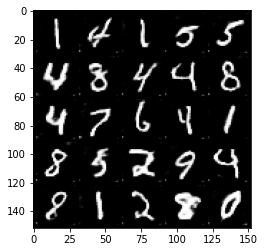

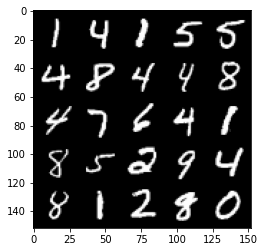

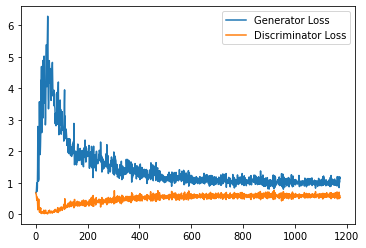

Step 24000: Generator loss: 0.9948555612564087, discriminator loss: 0.5939985252022744


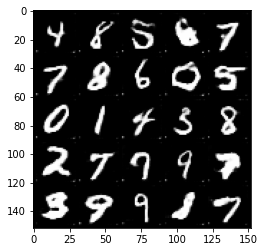

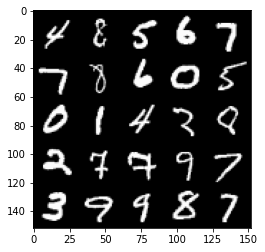

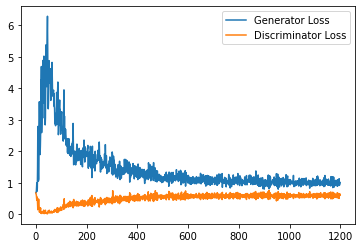

Step 24500: Generator loss: 1.0217321988344192, discriminator loss: 0.5814116702079773


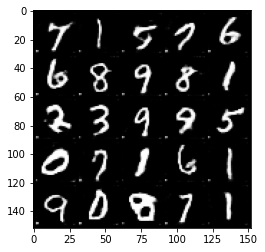

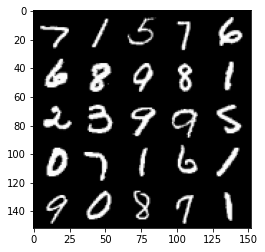

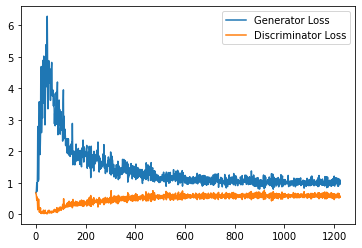

Step 25000: Generator loss: 1.0040583684444429, discriminator loss: 0.5897538968920708


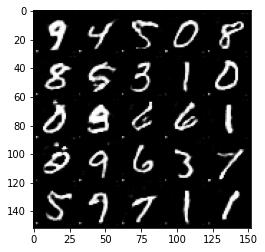

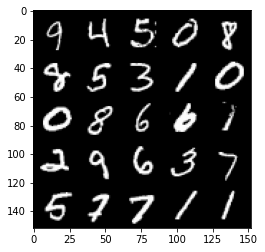

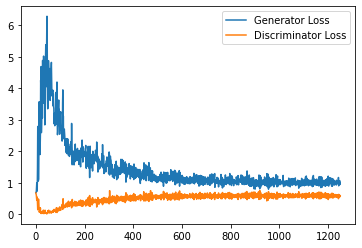

Step 25500: Generator loss: 1.0218058466911315, discriminator loss: 0.5834009751081467


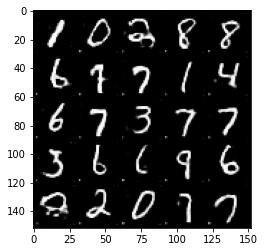

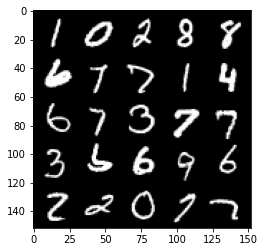

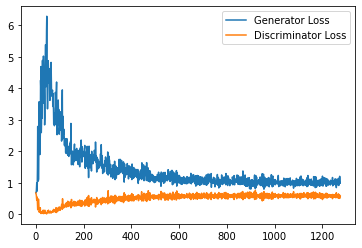

Step 26000: Generator loss: 1.0394992421865463, discriminator loss: 0.5876444507241249


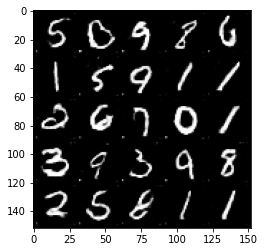

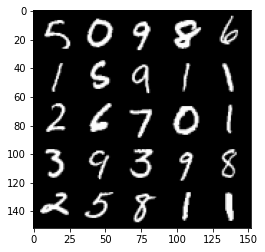

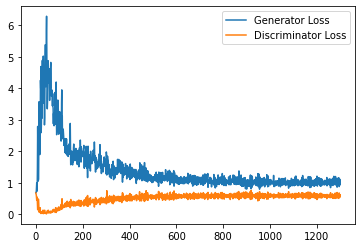

Step 26500: Generator loss: 1.0090389428138733, discriminator loss: 0.5816523104906082


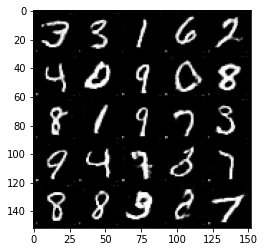

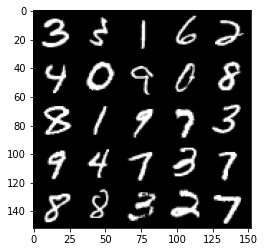

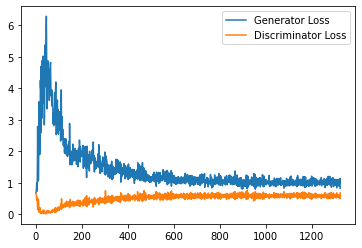

Step 27000: Generator loss: 1.0168617051839828, discriminator loss: 0.5783181091547013


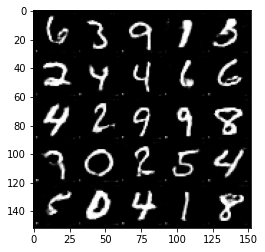

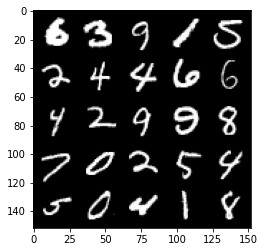

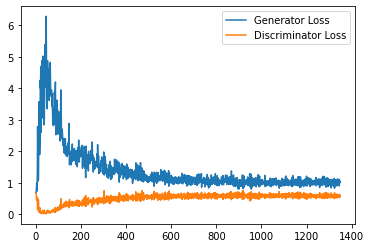

Step 27500: Generator loss: 1.0366775597333908, discriminator loss: 0.5801662067174912


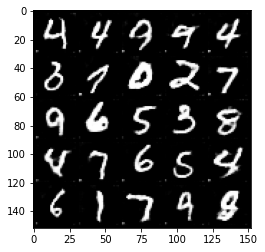

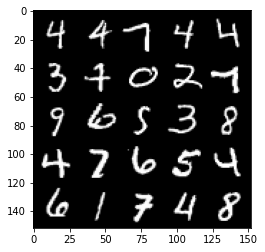

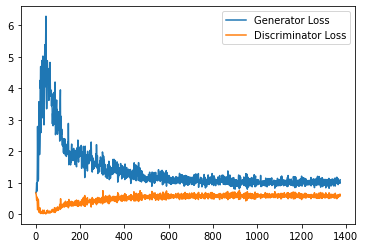

Step 28000: Generator loss: 1.058519687652588, discriminator loss: 0.5821863920092583


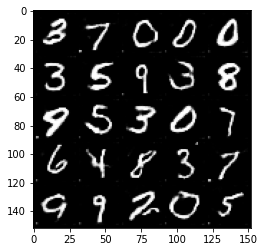

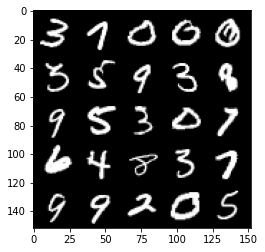

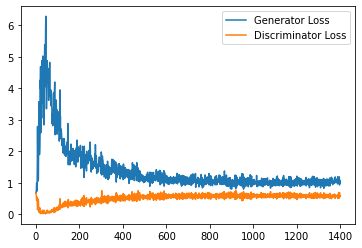

Step 28500: Generator loss: 1.056669167995453, discriminator loss: 0.5761943682432175


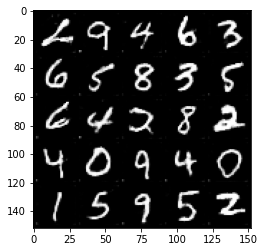

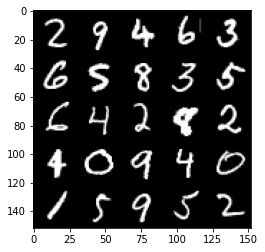

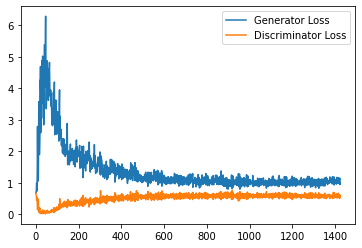

Step 29000: Generator loss: 1.0528849184513092, discriminator loss: 0.5789736430048943


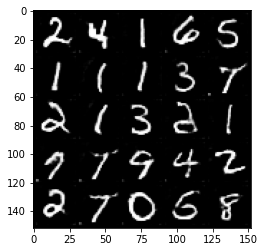

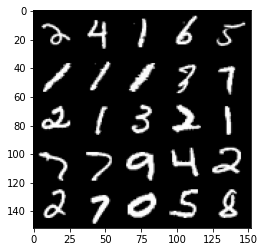

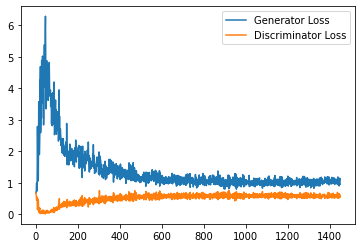

Step 29500: Generator loss: 1.0297307817935943, discriminator loss: 0.5781645064353943


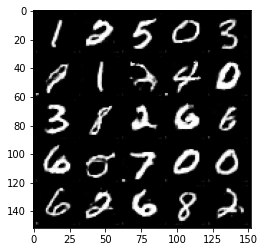

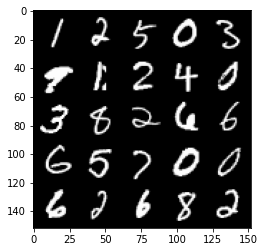

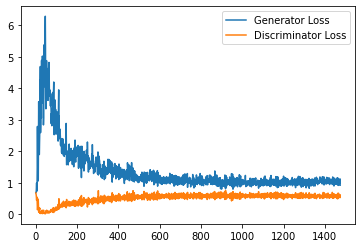

Step 30000: Generator loss: 1.0396483089923858, discriminator loss: 0.5696310859918594


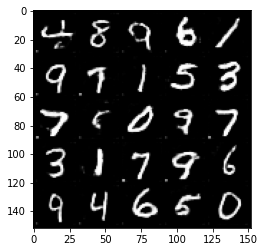

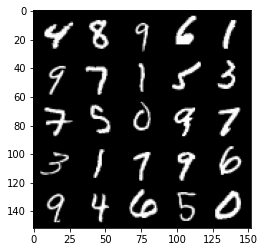

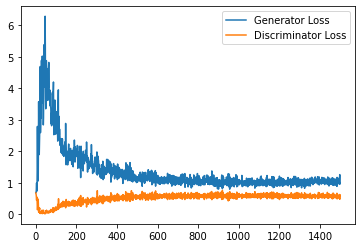

Step 30500: Generator loss: 1.025858404636383, discriminator loss: 0.5738979488611221


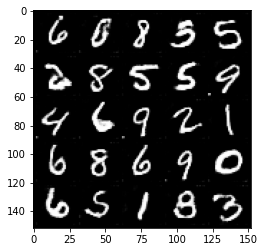

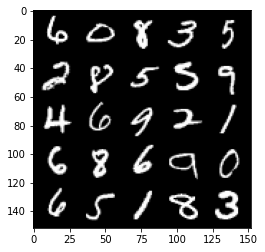

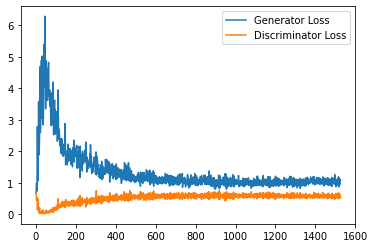

Step 31000: Generator loss: 1.0570999200344087, discriminator loss: 0.5652515440583229


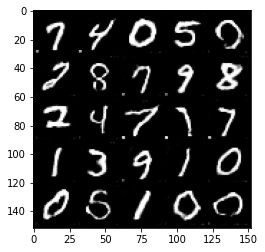

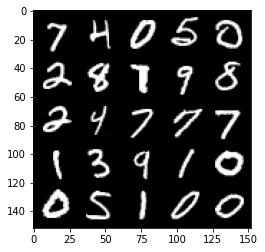

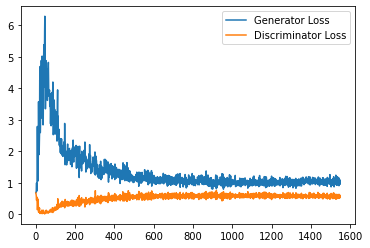

Step 31500: Generator loss: 1.0584492490291595, discriminator loss: 0.5652962209582328


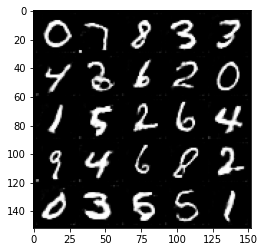

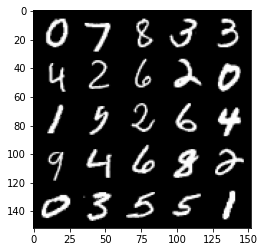

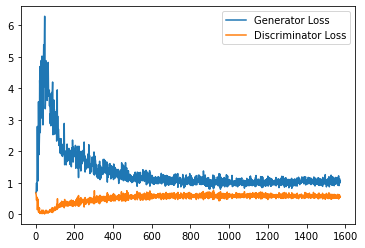

Step 32000: Generator loss: 1.0535047497749328, discriminator loss: 0.5611504710912705


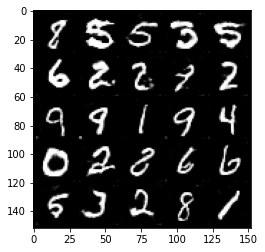

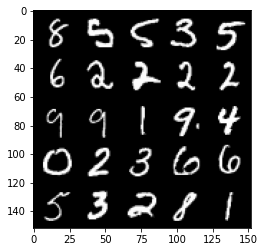

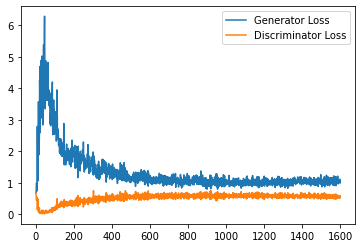

Step 32500: Generator loss: 1.064392898440361, discriminator loss: 0.5604585188627244


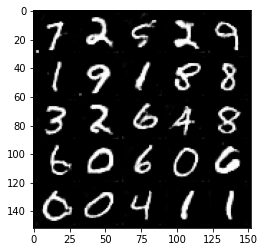

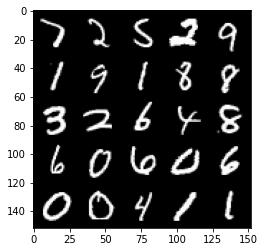

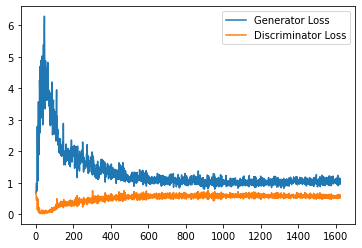

Step 33000: Generator loss: 1.0751753081083297, discriminator loss: 0.5620416100621224


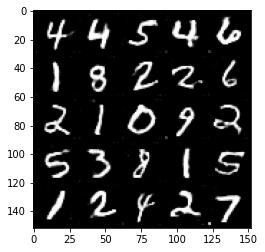

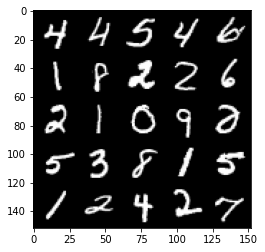

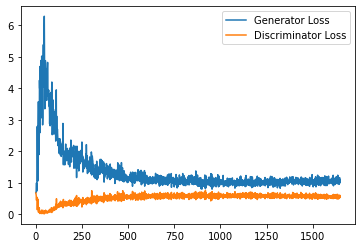

Step 33500: Generator loss: 1.0639820477962494, discriminator loss: 0.5607490552663803


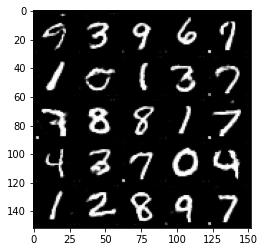

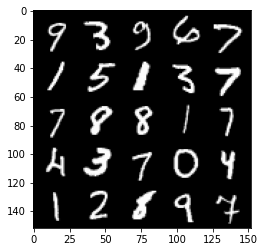

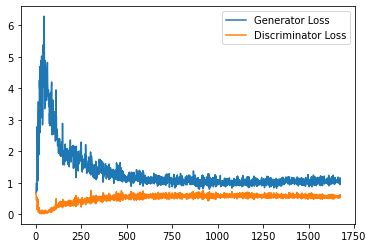

Step 34000: Generator loss: 1.0867500841617583, discriminator loss: 0.5546679158806801


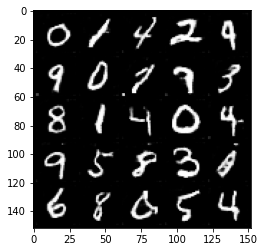

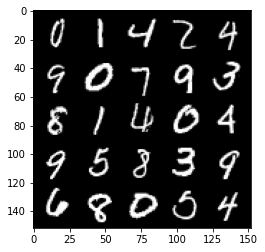

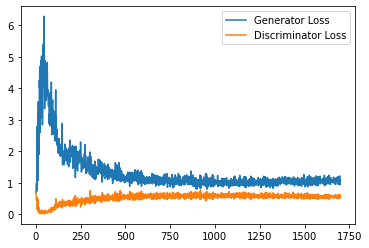

Step 34500: Generator loss: 1.1028083511590958, discriminator loss: 0.5607049448490142


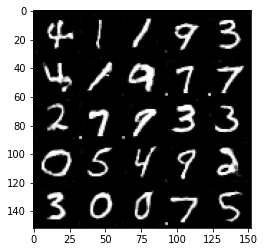

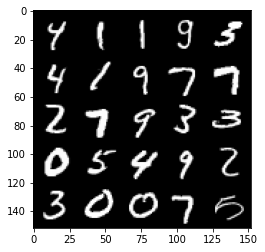

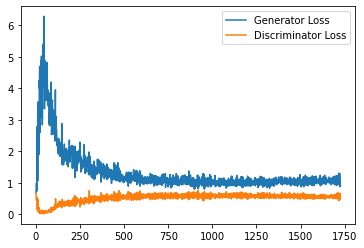

Step 35000: Generator loss: 1.0680728603601455, discriminator loss: 0.5582370102405548


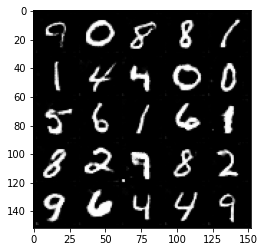

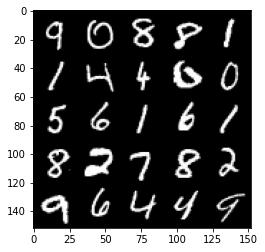

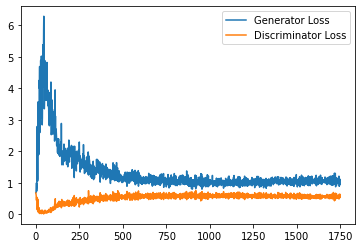

Step 35500: Generator loss: 1.0836721923351287, discriminator loss: 0.5522079035043717


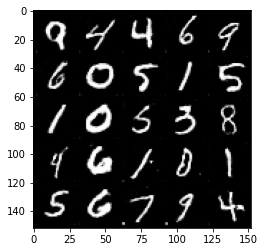

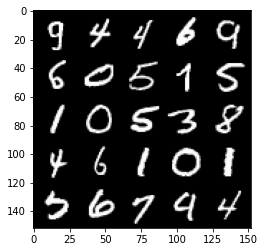

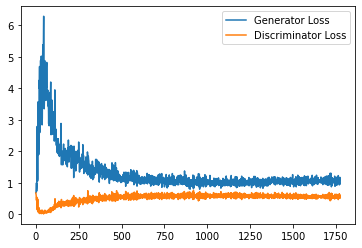

Step 36000: Generator loss: 1.0841878744363784, discriminator loss: 0.5481332835555076


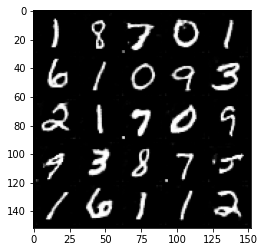

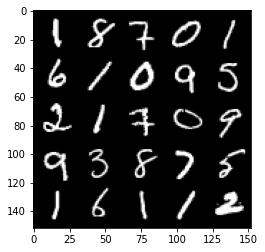

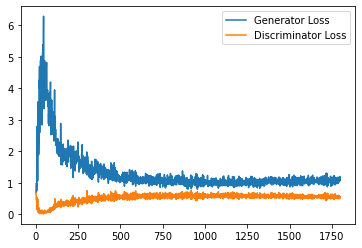

Step 36500: Generator loss: 1.0914170172214508, discriminator loss: 0.5484653588533401


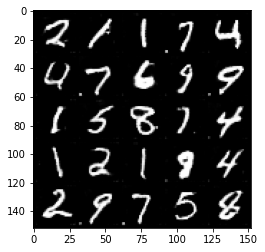

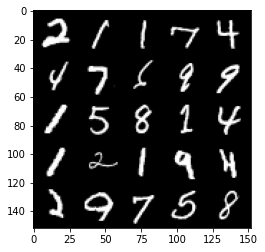

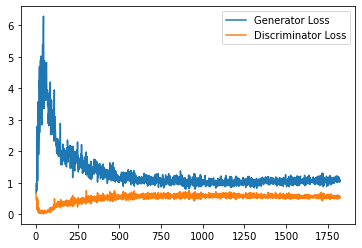

Step 37000: Generator loss: 1.0910247741937638, discriminator loss: 0.5528475006818772


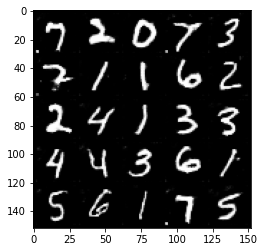

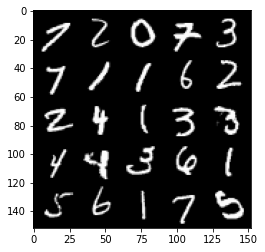

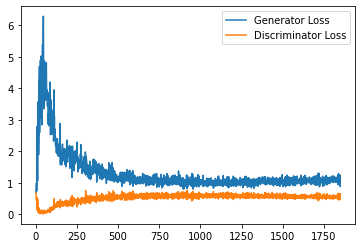

Step 37500: Generator loss: 1.0924141323566436, discriminator loss: 0.5482534729242324


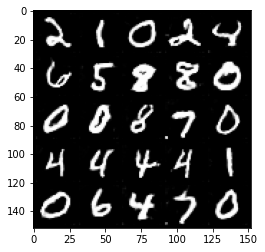

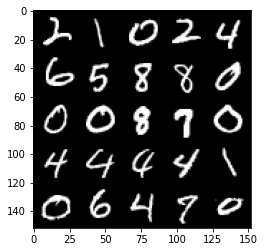

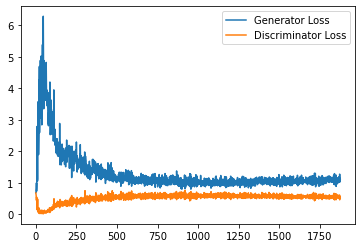

Step 38000: Generator loss: 1.087136612534523, discriminator loss: 0.5507302020788193


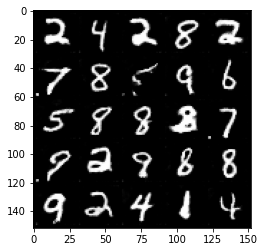

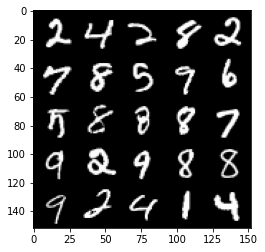

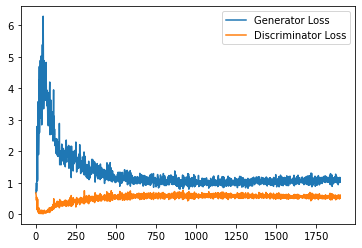

Step 38500: Generator loss: 1.0885247094631194, discriminator loss: 0.5460126703977585


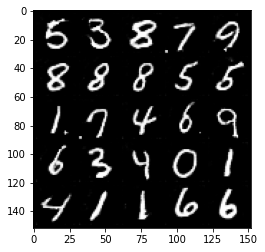

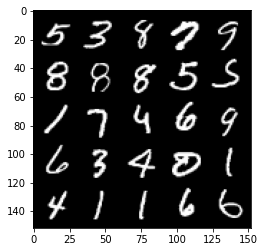

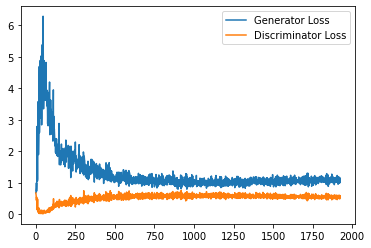

Step 39000: Generator loss: 1.1056362085342408, discriminator loss: 0.544219712972641


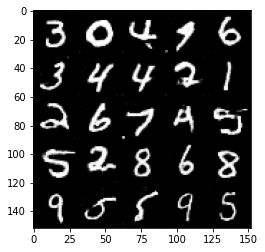

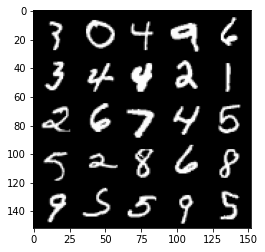

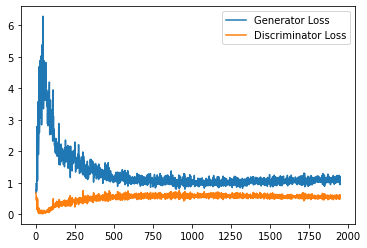

Step 39500: Generator loss: 1.08658551967144, discriminator loss: 0.5519051362872124


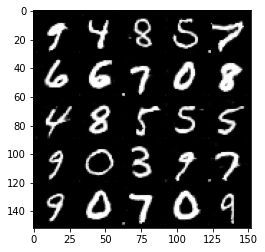

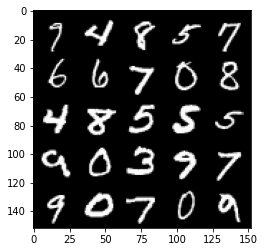

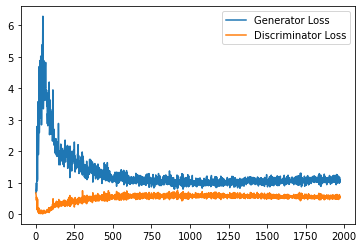

Step 40000: Generator loss: 1.0946025596857072, discriminator loss: 0.5432664277553558


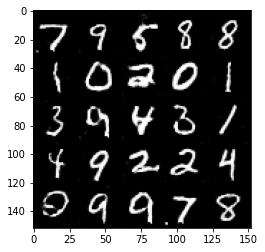

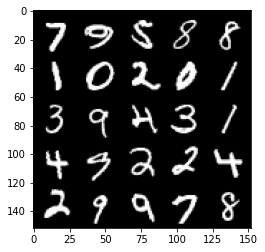

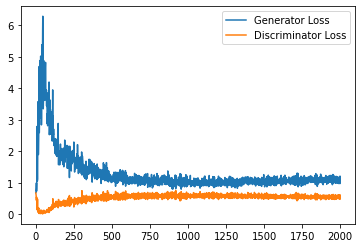

Step 40500: Generator loss: 1.125836693406105, discriminator loss: 0.5443823533058166


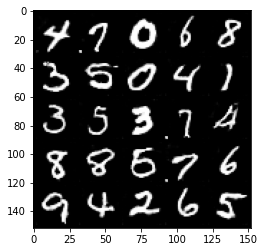

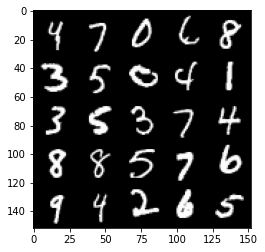

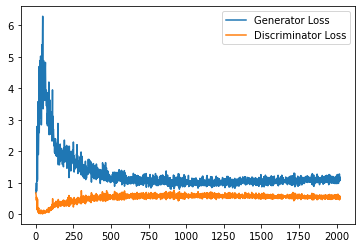

Step 41000: Generator loss: 1.1065837914943695, discriminator loss: 0.5456011086702347


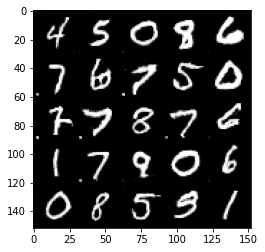

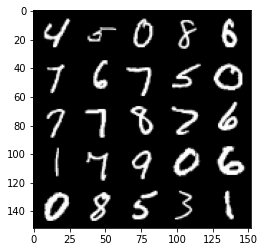

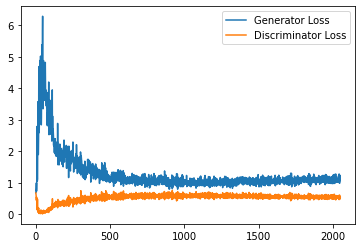

Step 41500: Generator loss: 1.1055632675886153, discriminator loss: 0.5438773783445359


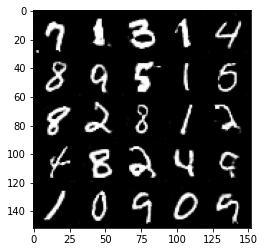

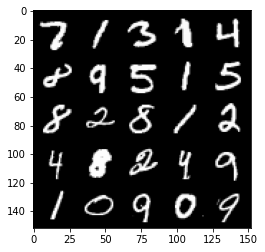

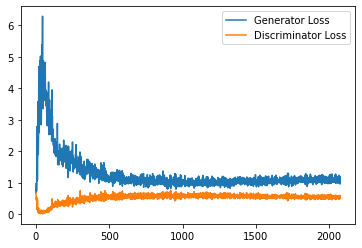

Step 42000: Generator loss: 1.1032276318073273, discriminator loss: 0.5437296254634857


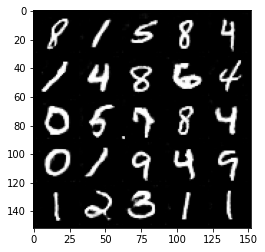

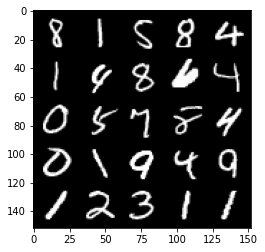

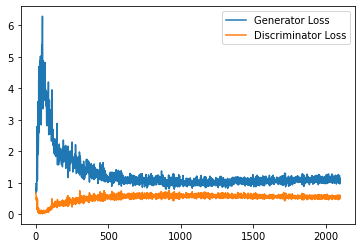

Step 42500: Generator loss: 1.0942797631025314, discriminator loss: 0.546966636300087


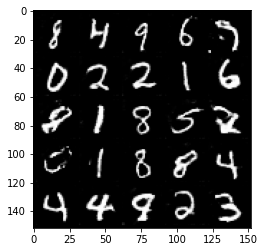

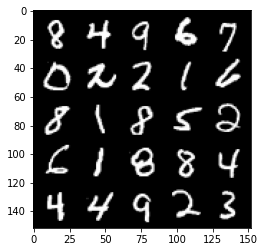

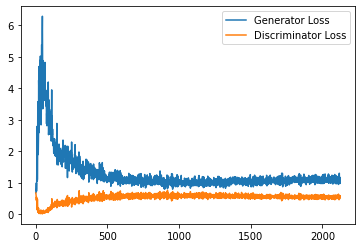

Step 43000: Generator loss: 1.0777151777744294, discriminator loss: 0.5416474030613899


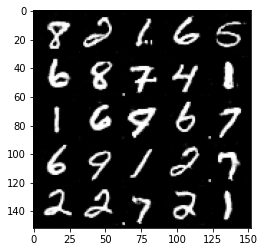

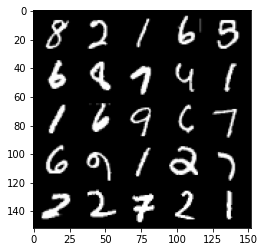

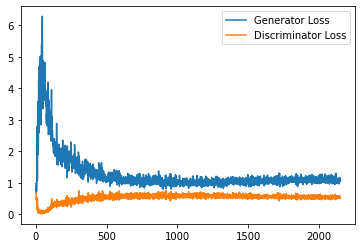

Step 43500: Generator loss: 1.0895403472185134, discriminator loss: 0.547540500998497


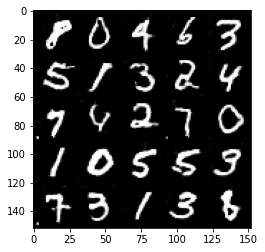

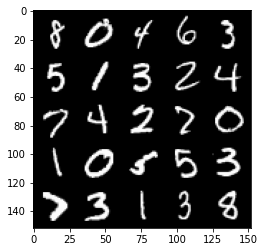

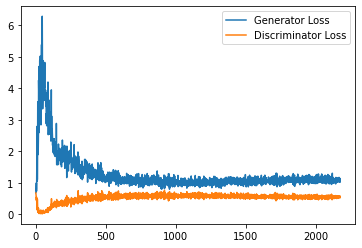

Step 44000: Generator loss: 1.0995656383037566, discriminator loss: 0.5454846139550209


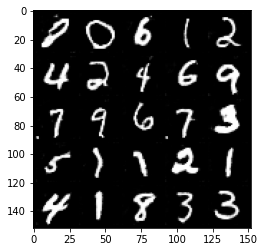

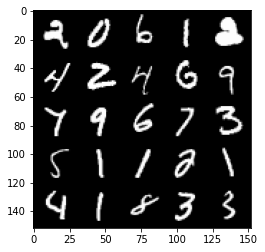

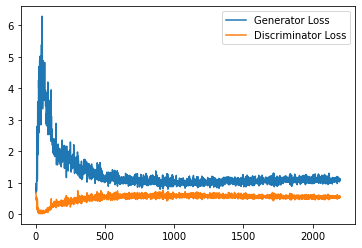

Step 44500: Generator loss: 1.0811470688581466, discriminator loss: 0.541771022439003


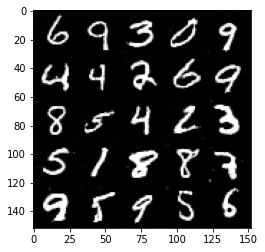

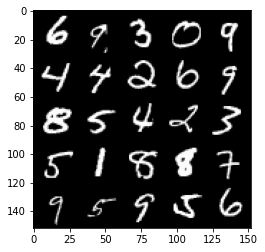

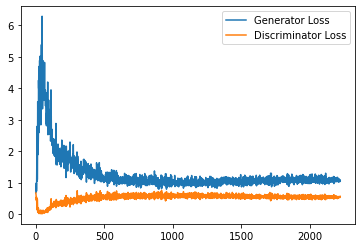

Step 45000: Generator loss: 1.102527076125145, discriminator loss: 0.5432626748681069


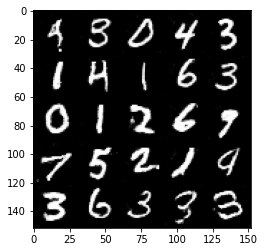

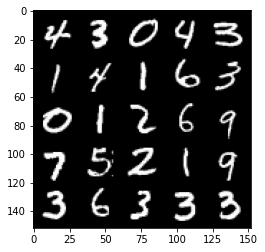

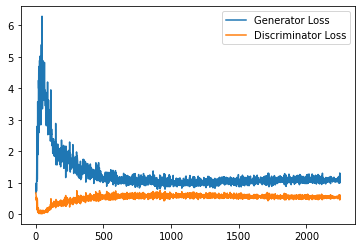

Step 45500: Generator loss: 1.1064380946159362, discriminator loss: 0.5450092574357986


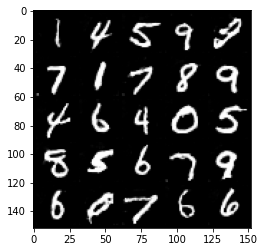

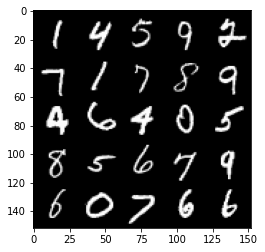

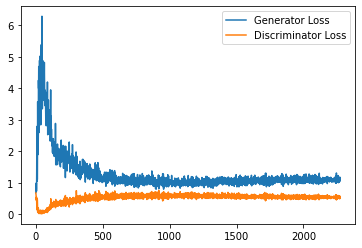

Step 46000: Generator loss: 1.1117733236551284, discriminator loss: 0.5474869639277459


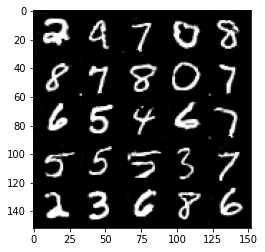

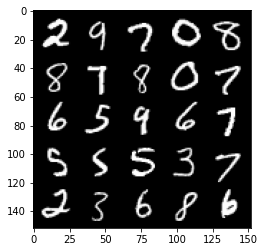

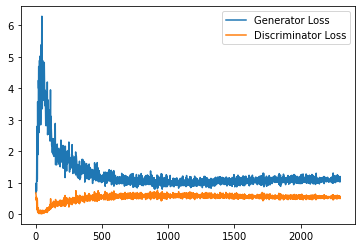

Step 46500: Generator loss: 1.115390364766121, discriminator loss: 0.5436057834625244


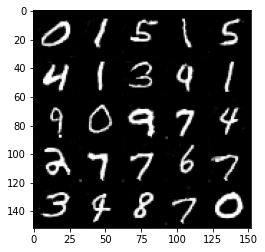

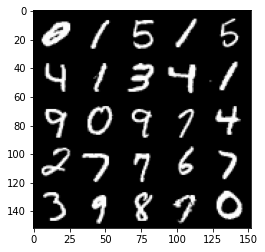

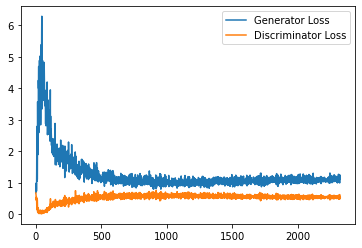

Step 47000: Generator loss: 1.111463408589363, discriminator loss: 0.5420076215863228


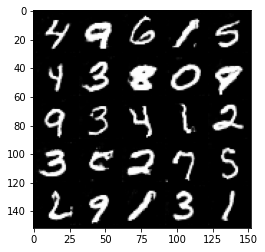

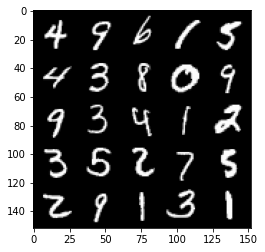

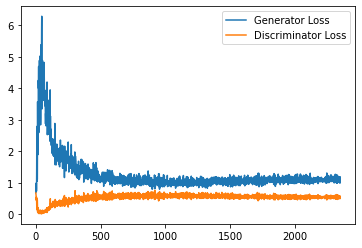

Step 47500: Generator loss: 1.0873301141262055, discriminator loss: 0.5436852549910546


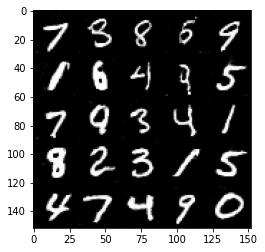

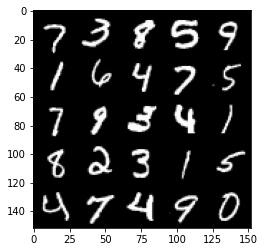

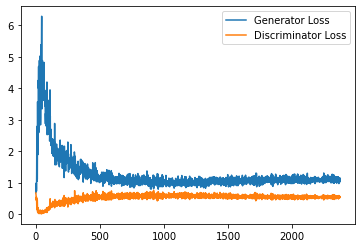

Step 48000: Generator loss: 1.122521810889244, discriminator loss: 0.5396781163811684


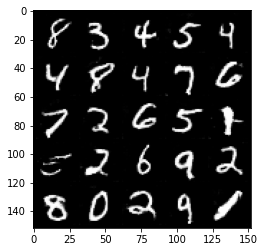

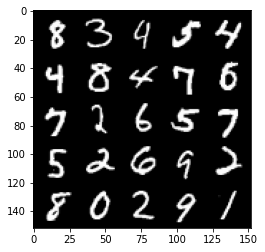

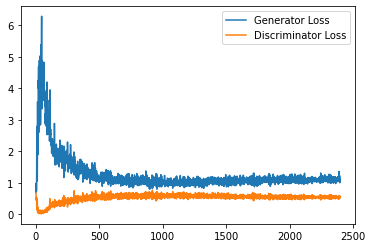

Step 48500: Generator loss: 1.1221093457937241, discriminator loss: 0.5440706284642219


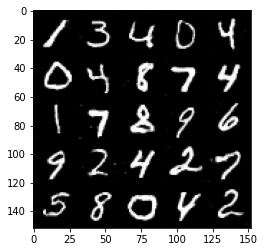

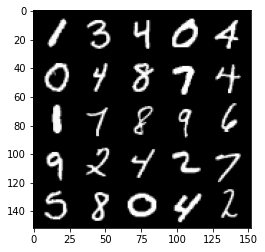

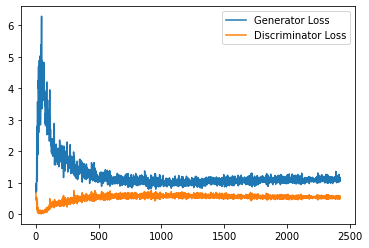

Step 49000: Generator loss: 1.1042059164047242, discriminator loss: 0.5391417689919472


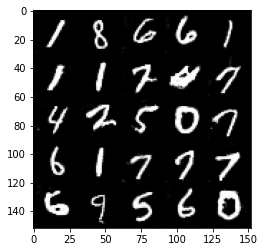

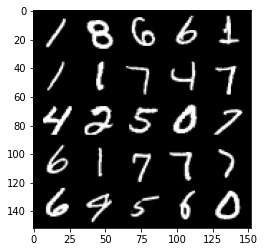

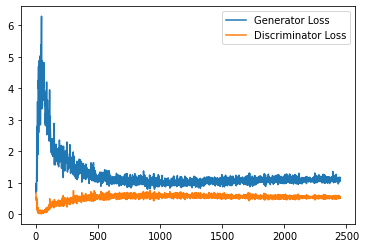

Step 49500: Generator loss: 1.1301237120628358, discriminator loss: 0.5426825285553932


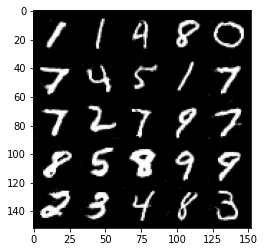

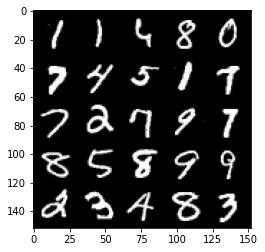

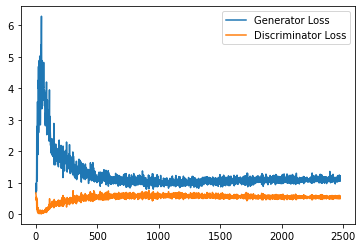

Step 50000: Generator loss: 1.122839166522026, discriminator loss: 0.5467518049478531


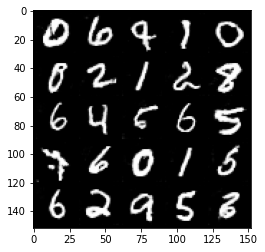

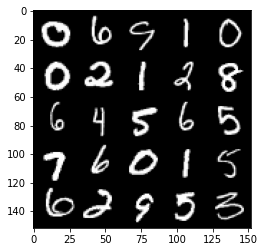

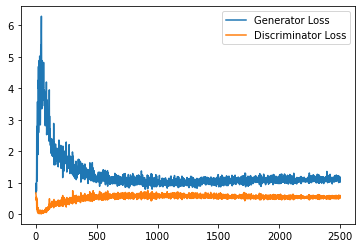

Step 50500: Generator loss: 1.1039666299819946, discriminator loss: 0.5465004505515099


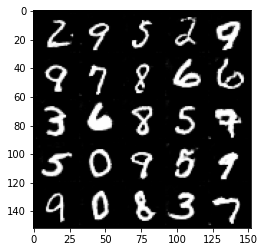

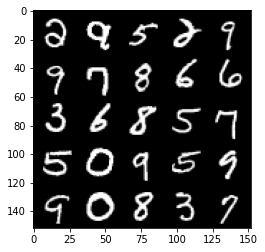

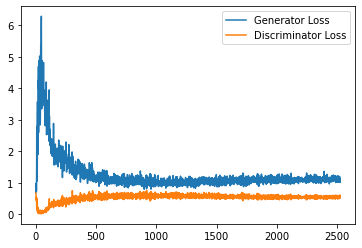

Step 51000: Generator loss: 1.1316110445261, discriminator loss: 0.5423914078474045


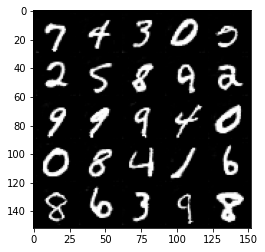

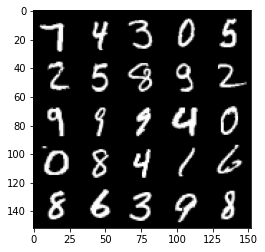

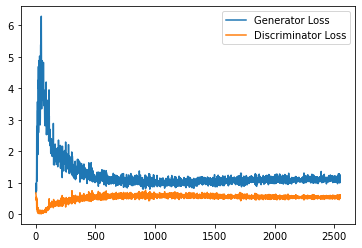

Step 51500: Generator loss: 1.1245065157413483, discriminator loss: 0.5409918703436851


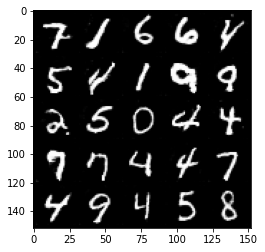

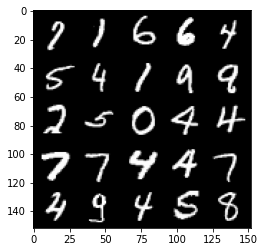

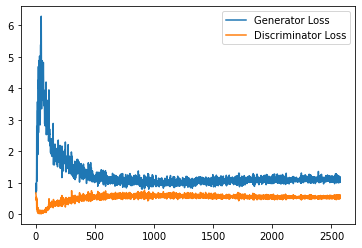

Step 52000: Generator loss: 1.148113099217415, discriminator loss: 0.5411731975078583


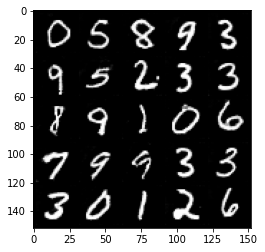

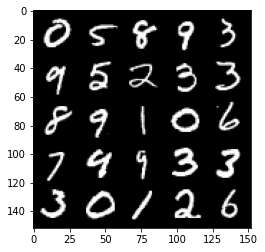

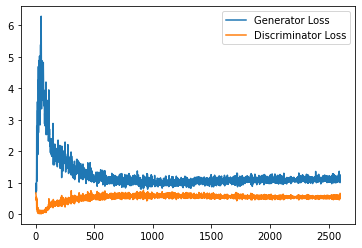

Step 52500: Generator loss: 1.134635223031044, discriminator loss: 0.545773667037487


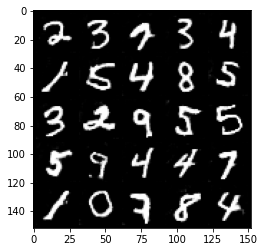

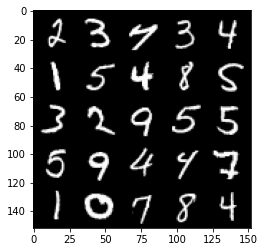

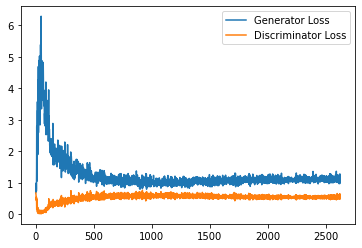

Step 53000: Generator loss: 1.1482625358104706, discriminator loss: 0.5466995533704758


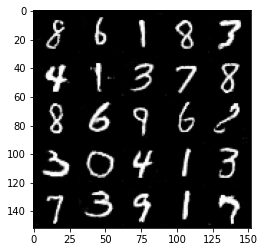

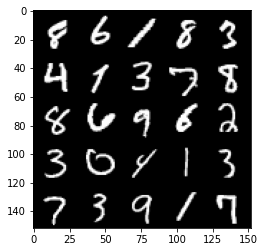

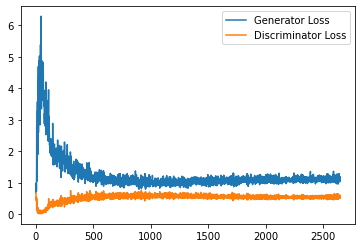

Step 53500: Generator loss: 1.1433022993803024, discriminator loss: 0.5443264883756638


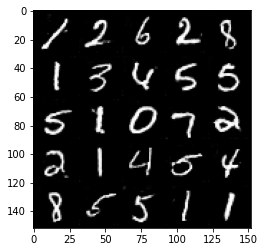

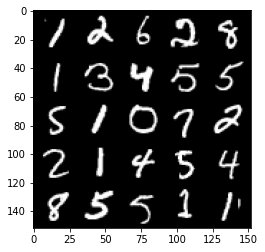

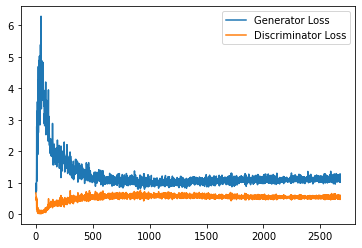

Step 54000: Generator loss: 1.124108605504036, discriminator loss: 0.5486450897455215


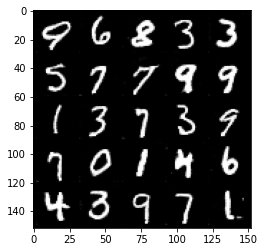

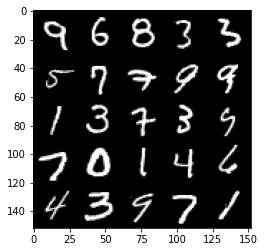

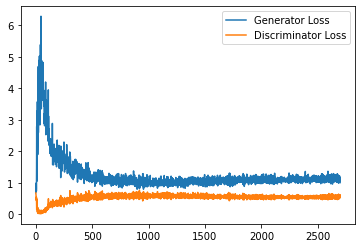

Step 54500: Generator loss: 1.1370472927093507, discriminator loss: 0.5425719514489173


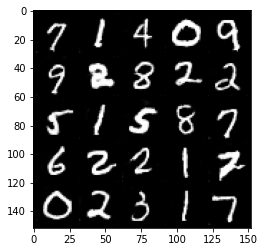

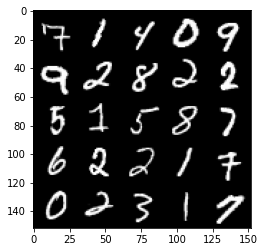

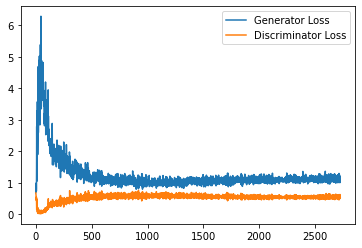

Step 55000: Generator loss: 1.1232027584314346, discriminator loss: 0.5446476786136627


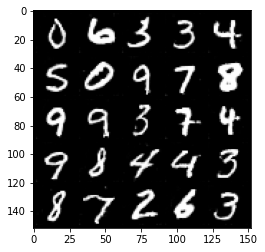

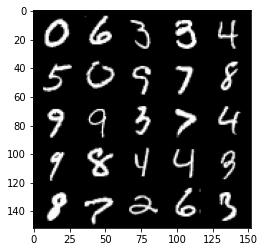

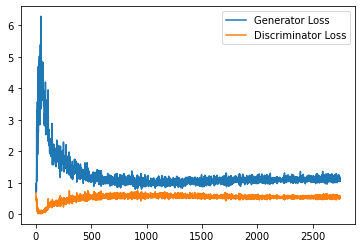

Step 55500: Generator loss: 1.1325985058546066, discriminator loss: 0.5435261623859405


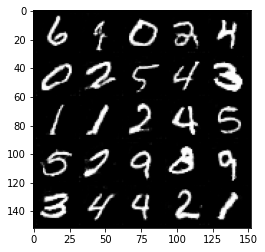

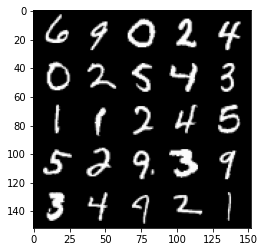

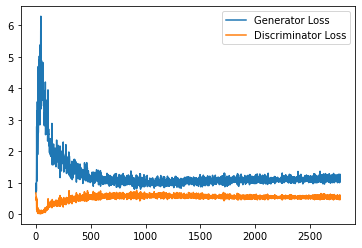

Step 56000: Generator loss: 1.1385993889570236, discriminator loss: 0.5511089594364166


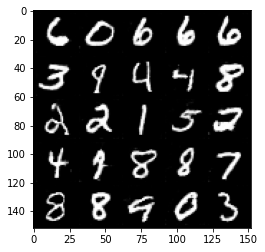

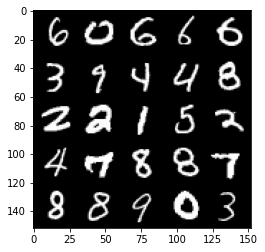

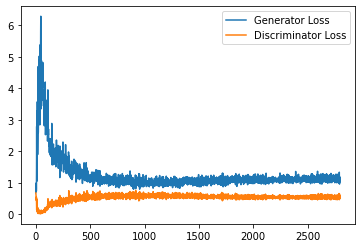

Step 56500: Generator loss: 1.129546850681305, discriminator loss: 0.5507619287967682


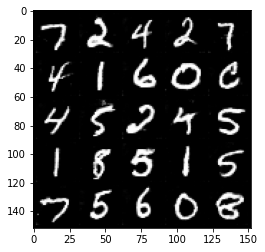

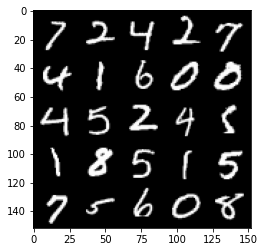

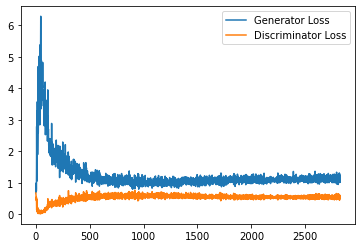

Step 57000: Generator loss: 1.152315721154213, discriminator loss: 0.5474891982078552


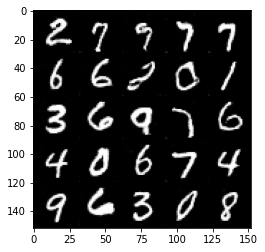

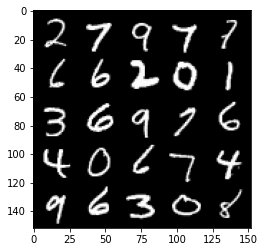

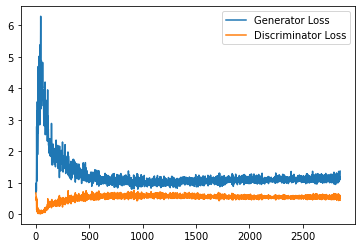

Step 57500: Generator loss: 1.1094682981967927, discriminator loss: 0.5550310254096985


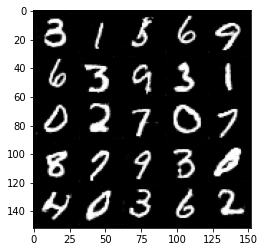

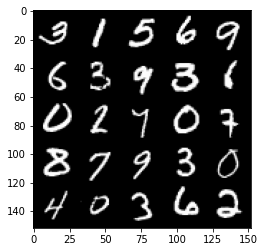

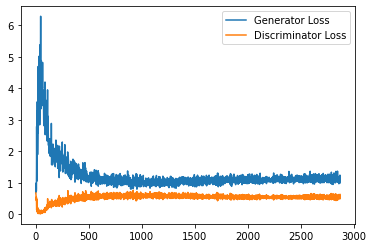

Step 58000: Generator loss: 1.1310169777870178, discriminator loss: 0.5429224036931991


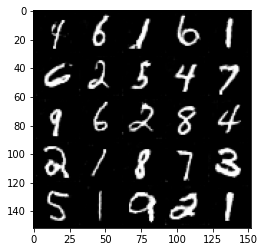

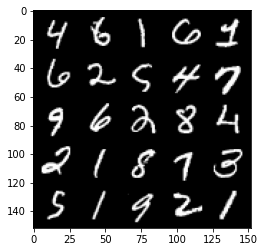

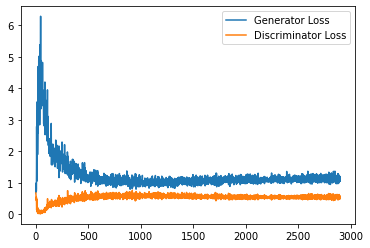

Step 58500: Generator loss: 1.1372690188884735, discriminator loss: 0.5451871966719627


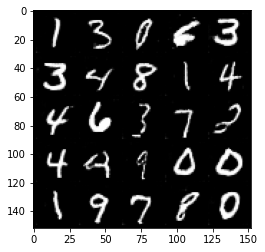

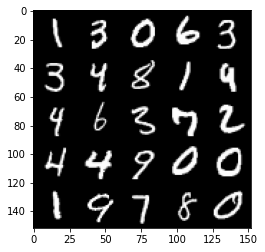

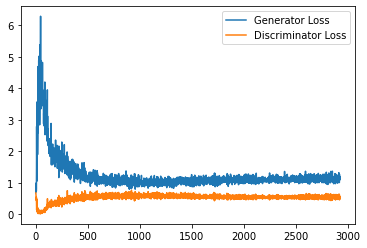

Step 59000: Generator loss: 1.1293949377536774, discriminator loss: 0.54940849006176


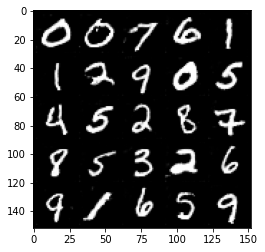

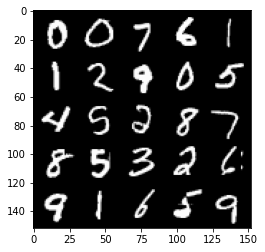

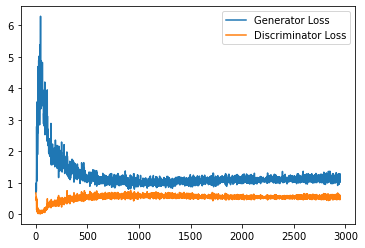

Step 59500: Generator loss: 1.1368875782489776, discriminator loss: 0.5556937581300736


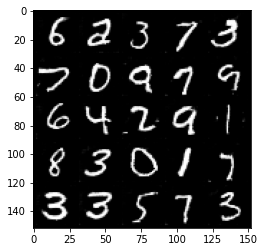

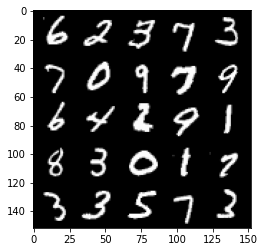

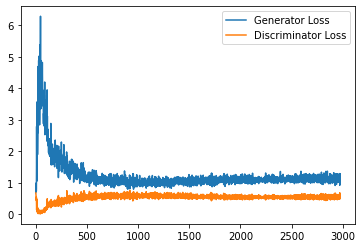

Step 60000: Generator loss: 1.146048408150673, discriminator loss: 0.542235813498497


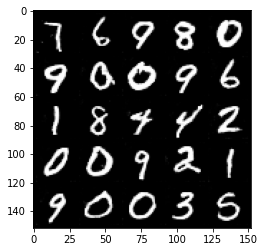

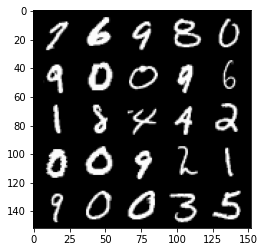

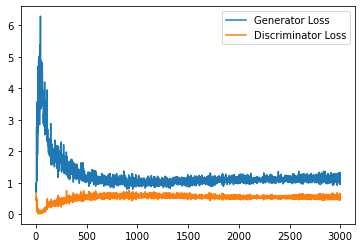

Step 60500: Generator loss: 1.1410410388708114, discriminator loss: 0.5507724767923355


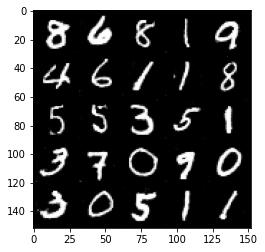

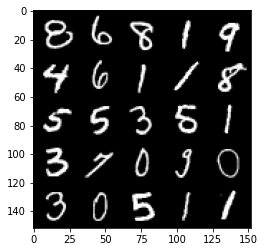

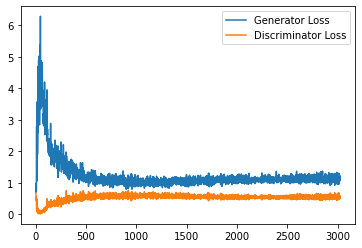

Step 61000: Generator loss: 1.1466692905426026, discriminator loss: 0.549275110900402


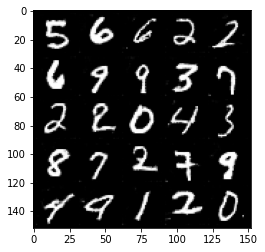

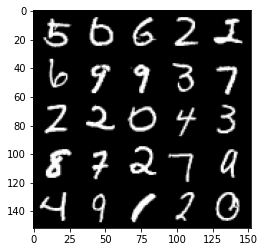

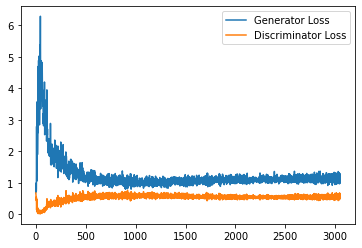

Step 61500: Generator loss: 1.1529760152101516, discriminator loss: 0.5506543759703636


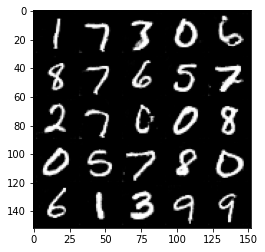

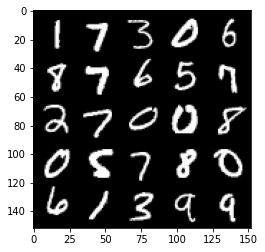

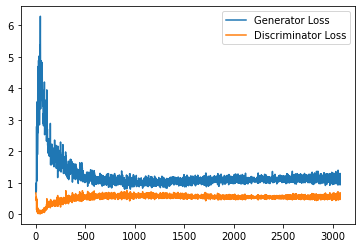

Step 62000: Generator loss: 1.1652127641439438, discriminator loss: 0.5477344634532928


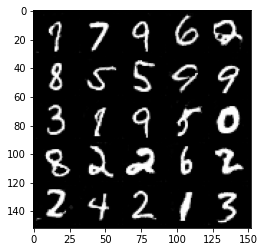

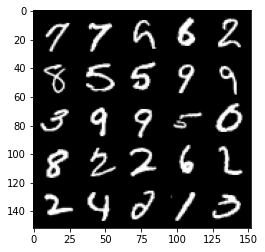

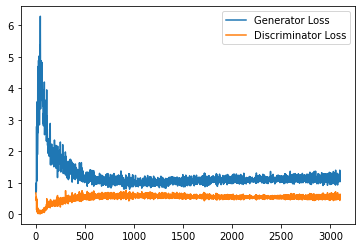

Step 62500: Generator loss: 1.1642470388412476, discriminator loss: 0.5404003793597222


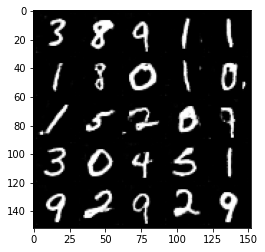

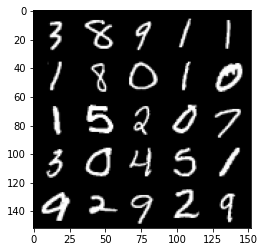

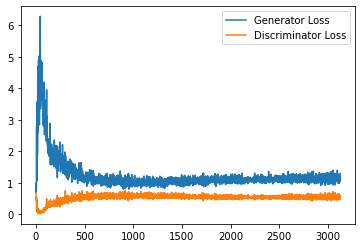

Step 63000: Generator loss: 1.1363284329175949, discriminator loss: 0.5525611456632614


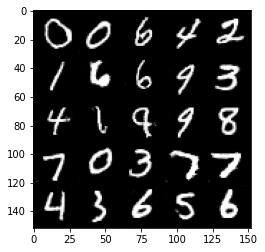

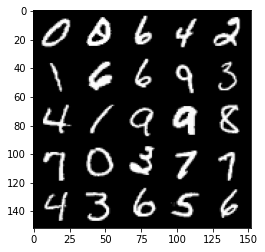

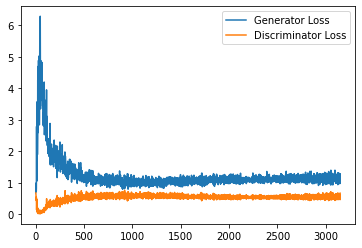

Step 63500: Generator loss: 1.1452754527330398, discriminator loss: 0.5393256930112839


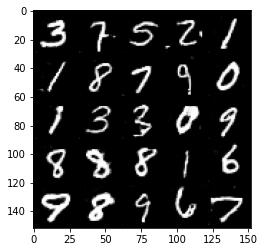

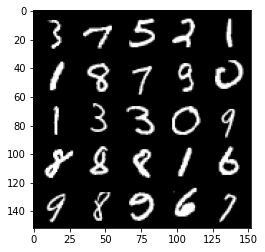

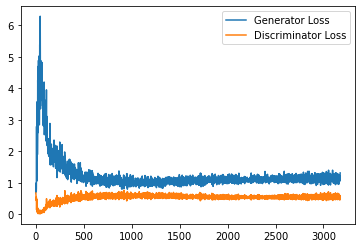

Step 64000: Generator loss: 1.13139808177948, discriminator loss: 0.5535298784971238


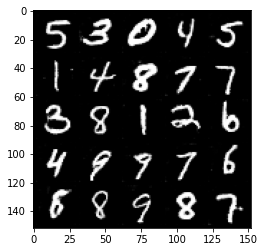

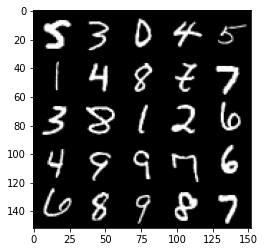

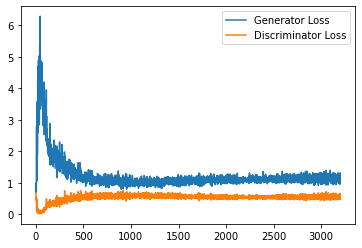

Step 64500: Generator loss: 1.1529001026153565, discriminator loss: 0.5529166127443313


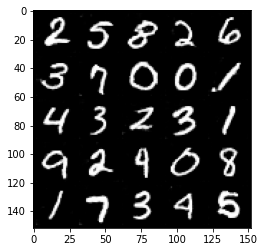

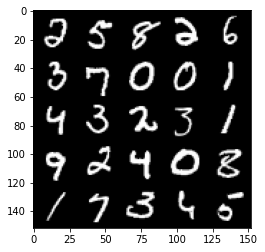

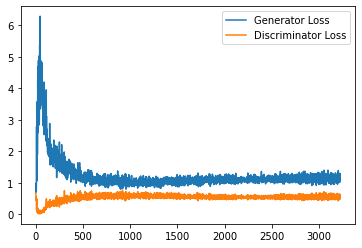

Step 65000: Generator loss: 1.1401297402381898, discriminator loss: 0.5472819798588753


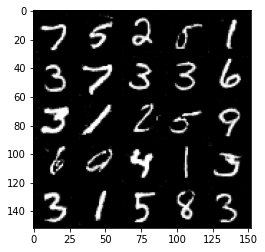

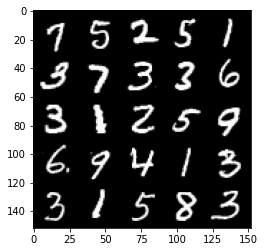

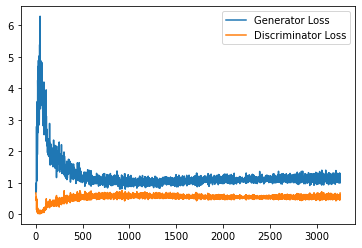

Step 65500: Generator loss: 1.1573190948963166, discriminator loss: 0.5460485063195228


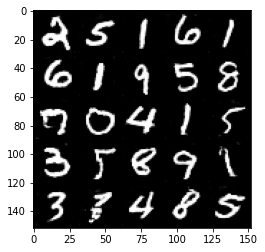

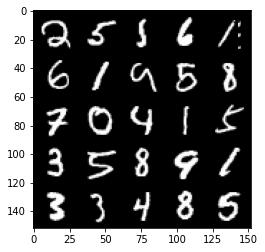

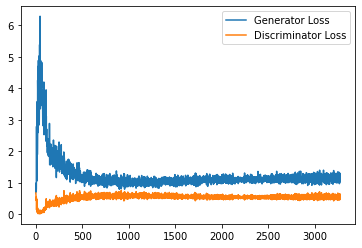

Step 66000: Generator loss: 1.1631994186639785, discriminator loss: 0.5495631723403931


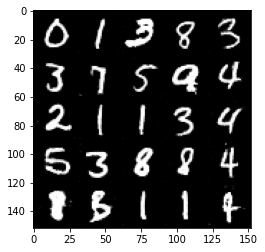

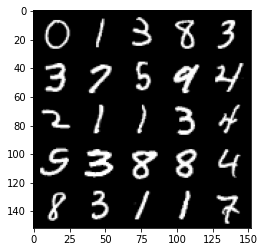

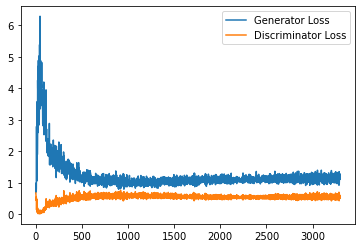

Step 66500: Generator loss: 1.1284668091535568, discriminator loss: 0.5493823201060295


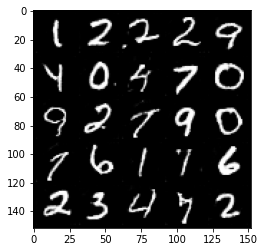

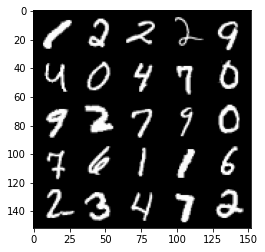

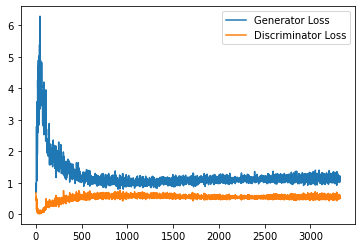

Step 67000: Generator loss: 1.1408263709545134, discriminator loss: 0.5503258415460587


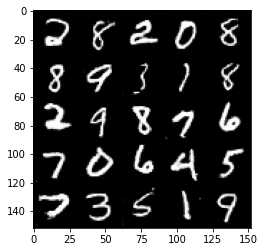

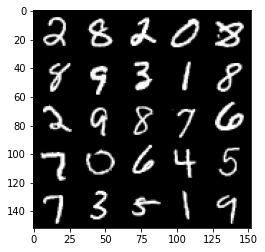

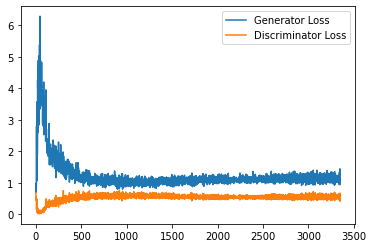

Step 67500: Generator loss: 1.1542161110639573, discriminator loss: 0.5406990730762482


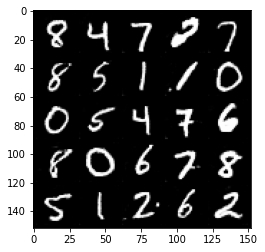

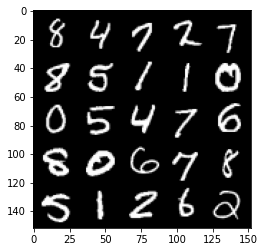

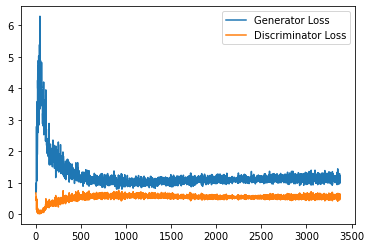

Step 68000: Generator loss: 1.1472614685297011, discriminator loss: 0.5541143676042557


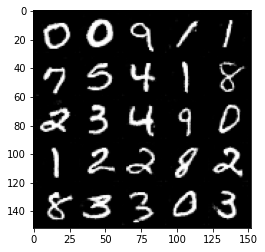

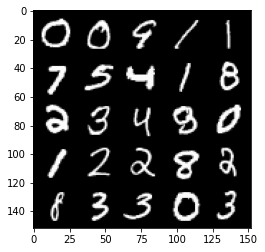

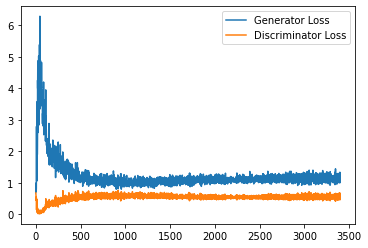

Step 68500: Generator loss: 1.1523204052448273, discriminator loss: 0.548504757463932


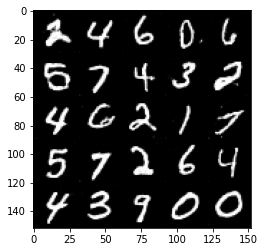

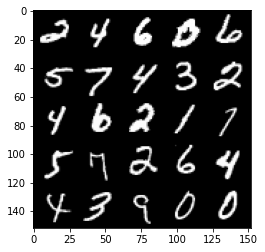

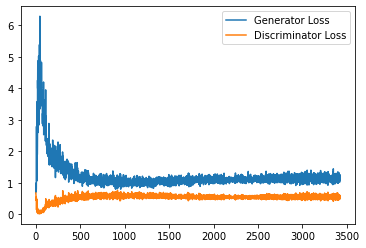

Step 69000: Generator loss: 1.1341585272550583, discriminator loss: 0.5546950933337211


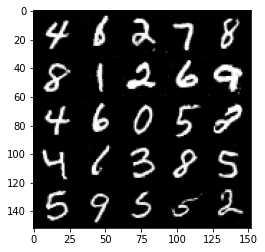

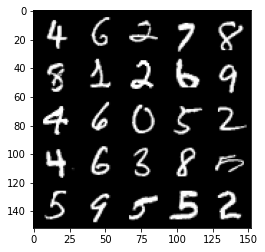

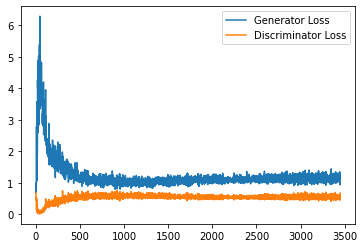

Step 69500: Generator loss: 1.1539782449007034, discriminator loss: 0.5460876951217651


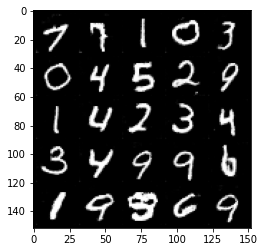

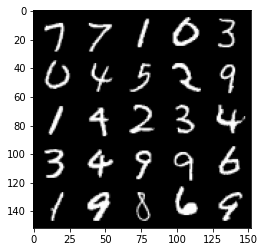

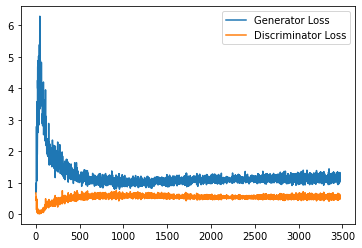

Step 70000: Generator loss: 1.1604574815034867, discriminator loss: 0.546094157576561


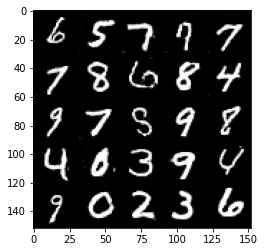

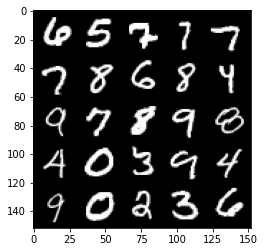

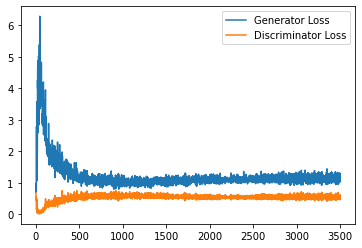

Step 70500: Generator loss: 1.147127796649933, discriminator loss: 0.5544059054851532


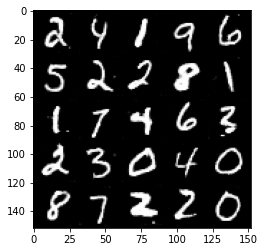

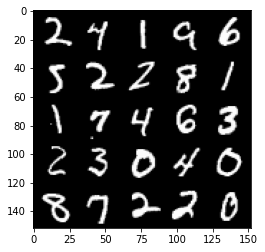

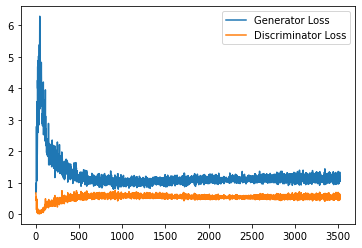

Step 71000: Generator loss: 1.1425526466369629, discriminator loss: 0.5508710786104202


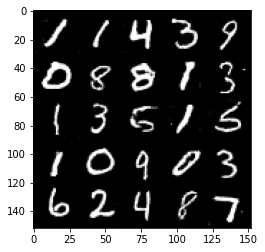

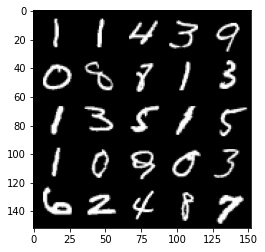

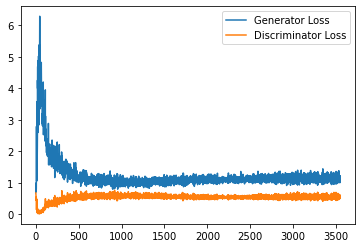

Step 71500: Generator loss: 1.1448810448646545, discriminator loss: 0.5505924310684204


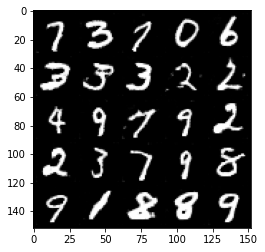

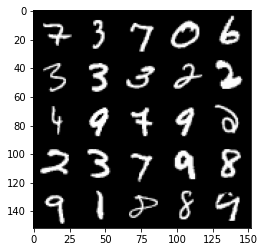

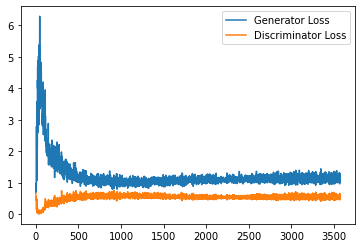

Step 72000: Generator loss: 1.1565543590784073, discriminator loss: 0.5493906001448632


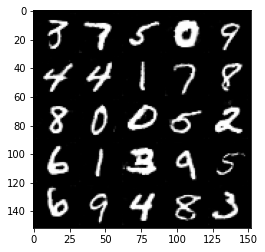

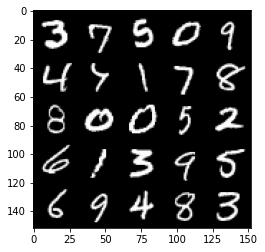

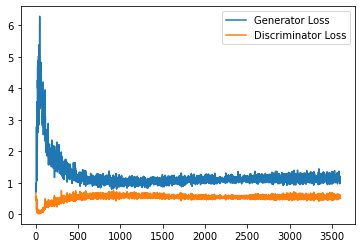

Step 72500: Generator loss: 1.1241603543758392, discriminator loss: 0.5581589939594269


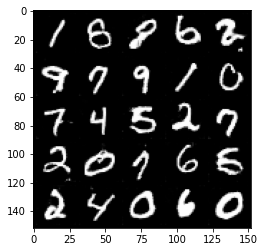

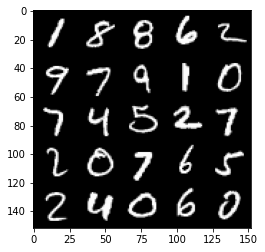

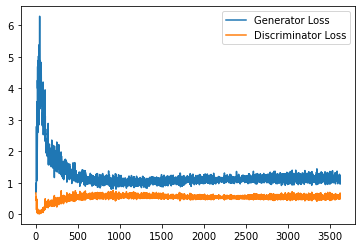

Step 73000: Generator loss: 1.1556886345148087, discriminator loss: 0.5485153113007546


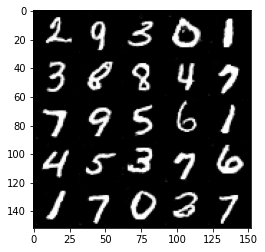

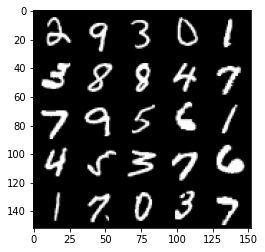

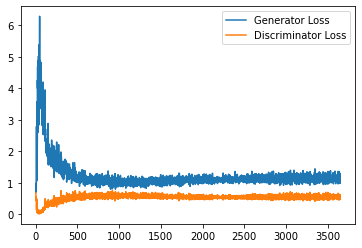

Step 73500: Generator loss: 1.1323379805088043, discriminator loss: 0.5497917385101319


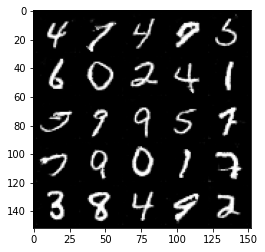

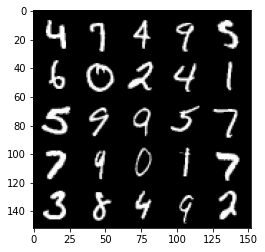

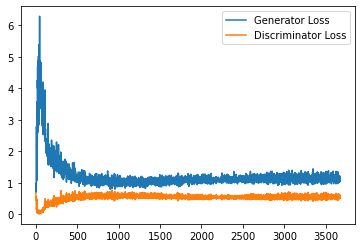

Step 74000: Generator loss: 1.1646529211997987, discriminator loss: 0.5471980840563774


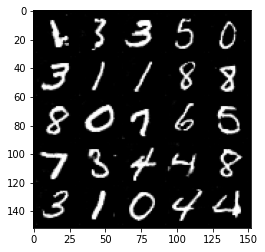

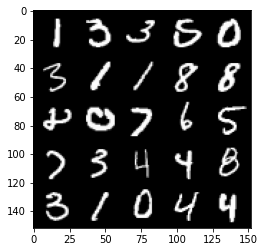

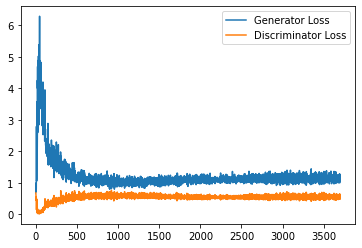

Step 74500: Generator loss: 1.1406977771520614, discriminator loss: 0.55277417075634


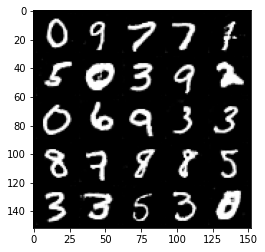

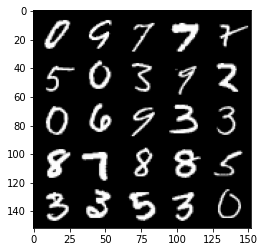

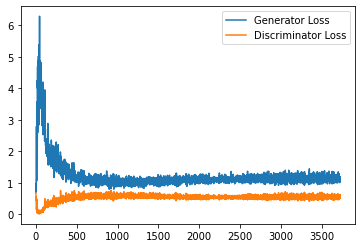

Step 75000: Generator loss: 1.1307337211370467, discriminator loss: 0.5565683460235595


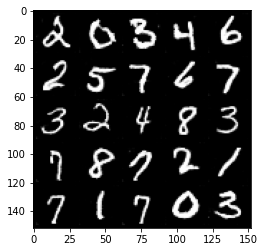

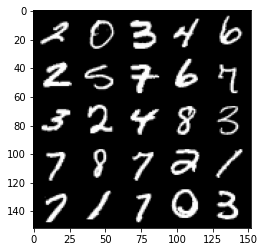

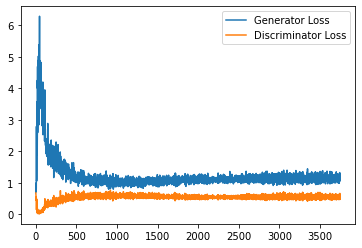

Step 75500: Generator loss: 1.134979971408844, discriminator loss: 0.5613667038083077


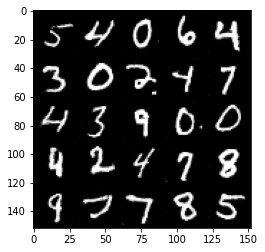

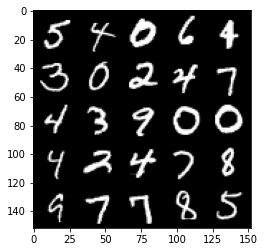

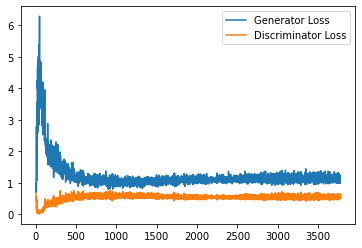

Step 76000: Generator loss: 1.1329424382448197, discriminator loss: 0.5581822137236595


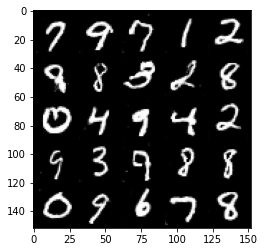

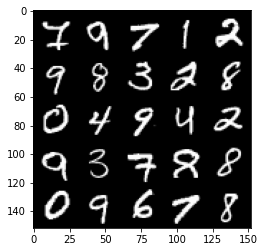

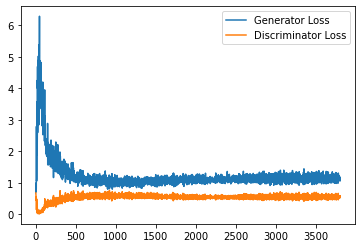

Step 76500: Generator loss: 1.151642593741417, discriminator loss: 0.5555851109623909


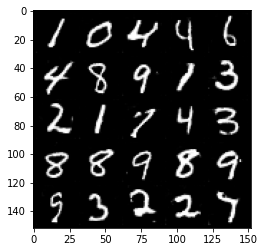

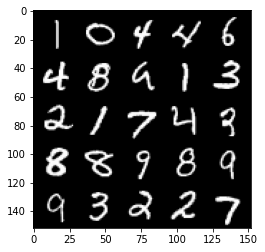

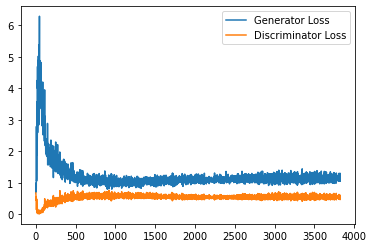

Step 77000: Generator loss: 1.105220583677292, discriminator loss: 0.5567528795003891


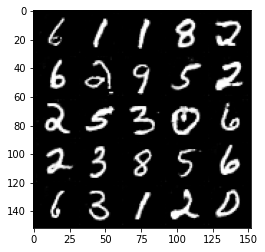

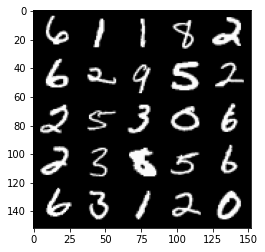

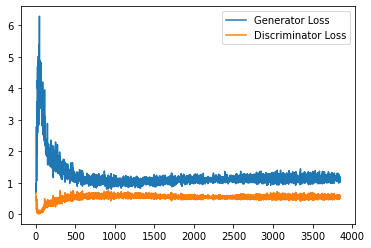

Step 77500: Generator loss: 1.1414877846240998, discriminator loss: 0.552440794467926


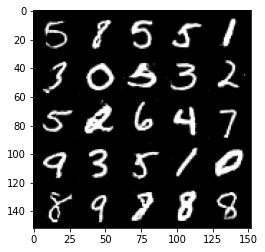

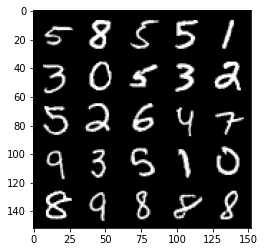

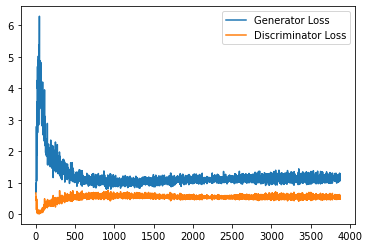

Step 78000: Generator loss: 1.1296822508573532, discriminator loss: 0.5587263963818551


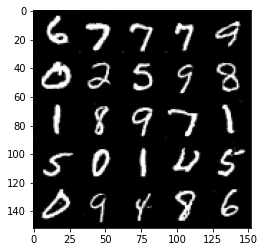

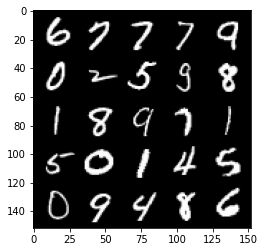

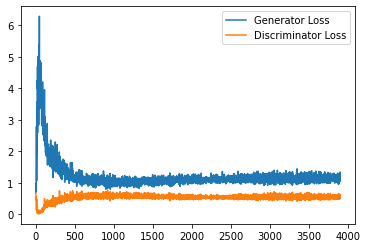

Step 78500: Generator loss: 1.1339004498720169, discriminator loss: 0.5657082998156547


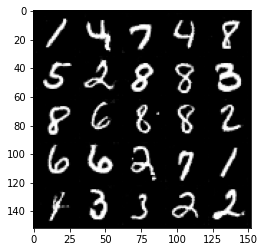

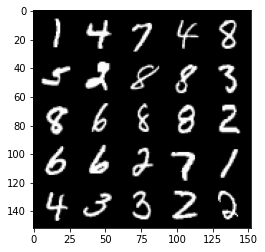

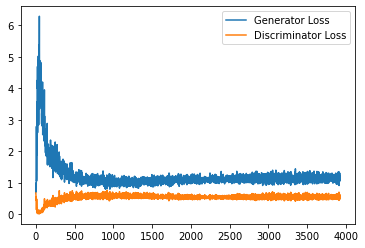

Step 79000: Generator loss: 1.1285320984125138, discriminator loss: 0.5546201279759407


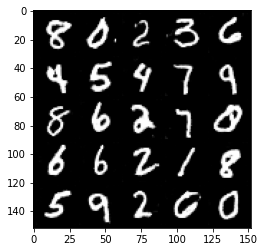

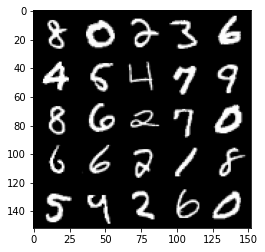

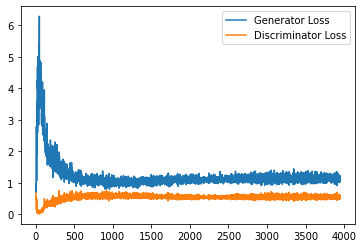

Step 79500: Generator loss: 1.1300609055757522, discriminator loss: 0.5579522689580917


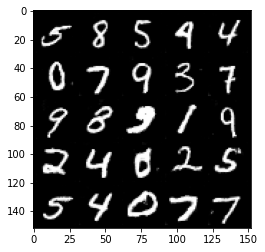

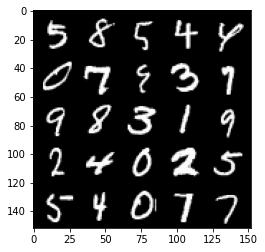

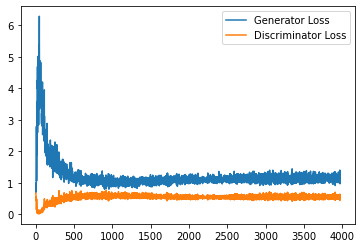

Step 80000: Generator loss: 1.1290045481920243, discriminator loss: 0.558788744211197


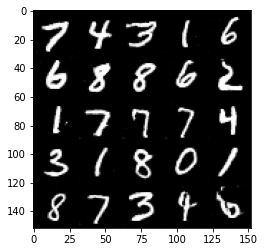

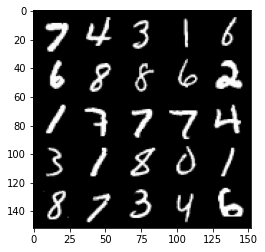

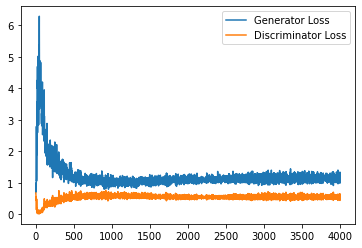

Step 80500: Generator loss: 1.1147655349969865, discriminator loss: 0.562662776529789


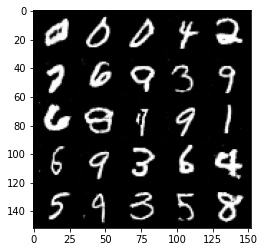

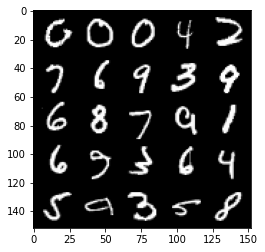

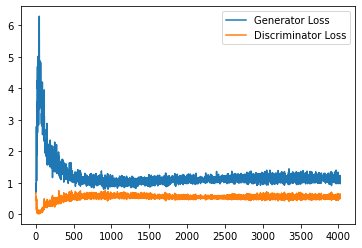

Step 81000: Generator loss: 1.1380726351737975, discriminator loss: 0.5599777759313583


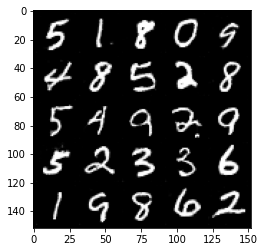

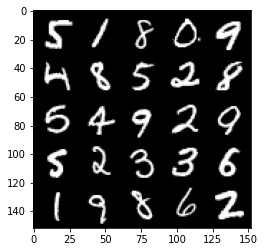

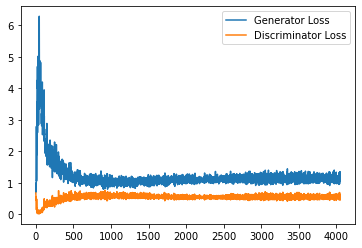

Step 81500: Generator loss: 1.146531605243683, discriminator loss: 0.5619698055386543


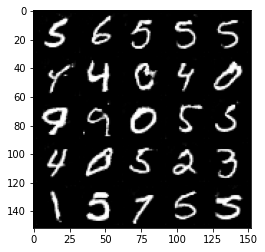

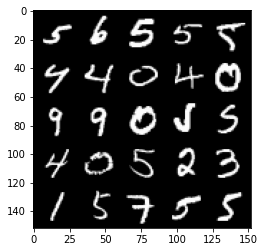

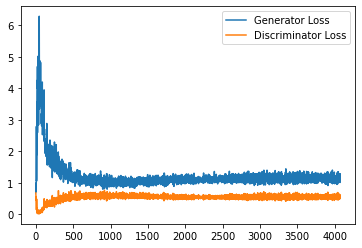

Step 82000: Generator loss: 1.1315096203088761, discriminator loss: 0.558831534743309


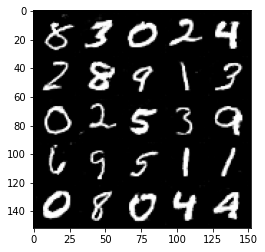

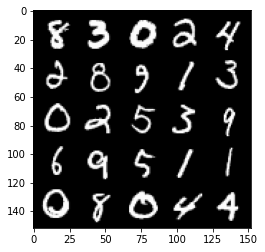

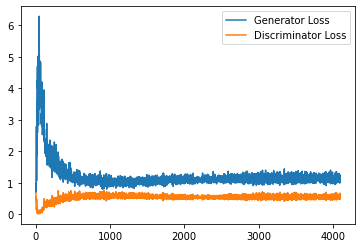

Step 82500: Generator loss: 1.1133700790405274, discriminator loss: 0.558038039445877


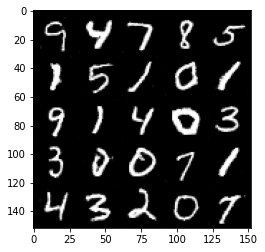

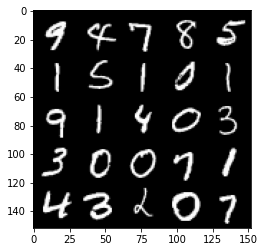

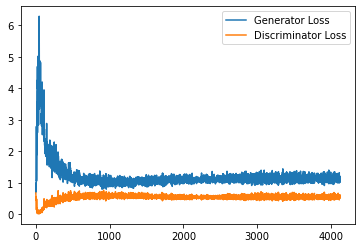

Step 83000: Generator loss: 1.141498409986496, discriminator loss: 0.5617166185975074


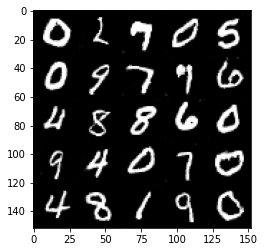

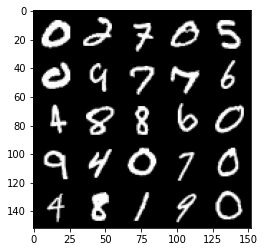

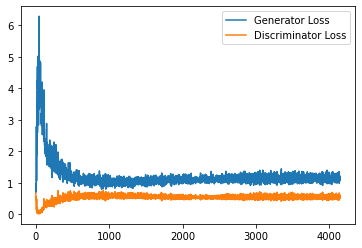

Step 83500: Generator loss: 1.1212069873809813, discriminator loss: 0.56482399559021


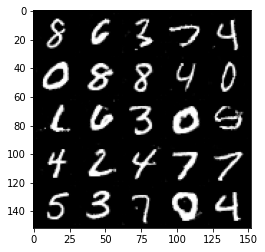

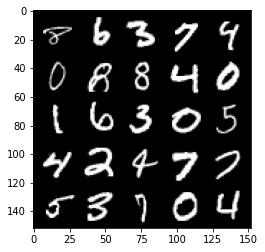

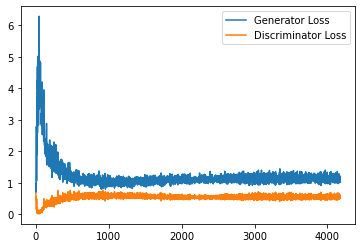

Step 84000: Generator loss: 1.1244795302152633, discriminator loss: 0.5594579142332077


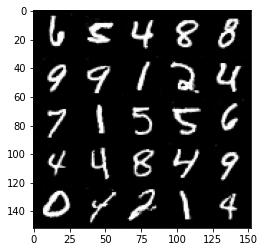

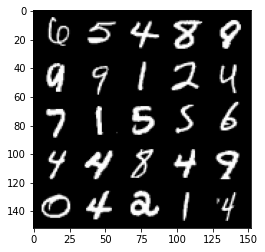

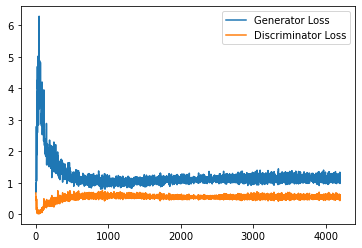

Step 84500: Generator loss: 1.1070080586671829, discriminator loss: 0.56051804459095


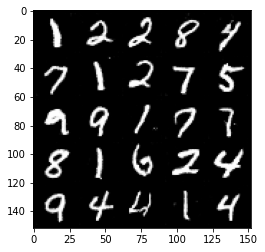

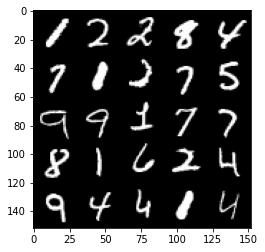

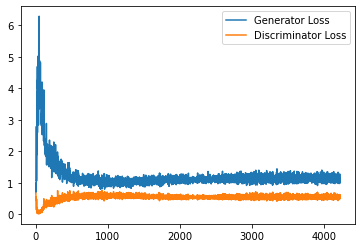

Step 85000: Generator loss: 1.1381396151781082, discriminator loss: 0.5594595384597778


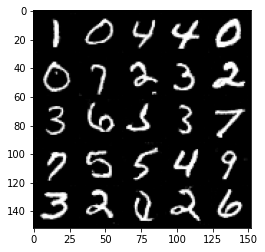

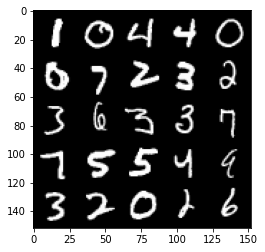

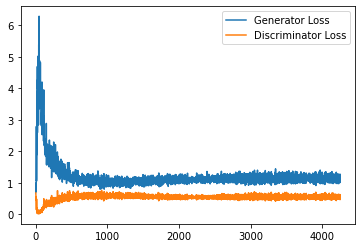

Step 85500: Generator loss: 1.1257866438627242, discriminator loss: 0.559419496178627


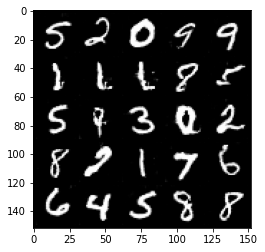

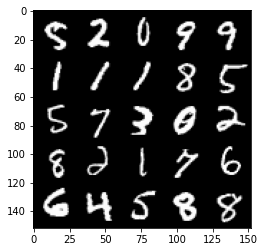

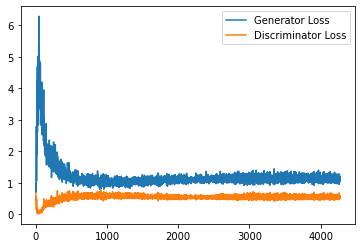

Step 86000: Generator loss: 1.1289341398477555, discriminator loss: 0.5624895997047424


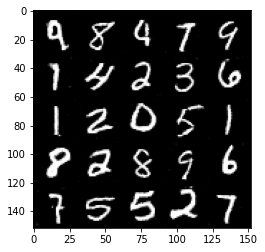

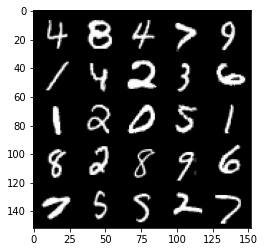

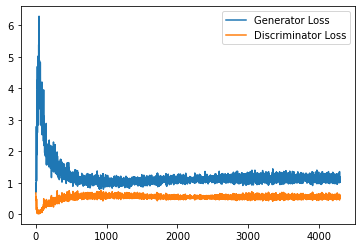

Step 86500: Generator loss: 1.115639151930809, discriminator loss: 0.5612065577507019


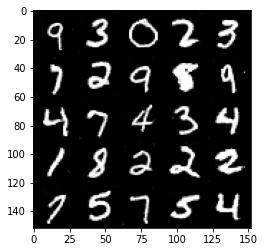

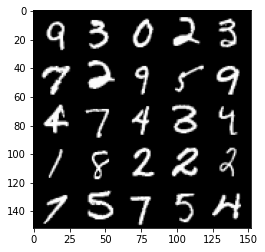

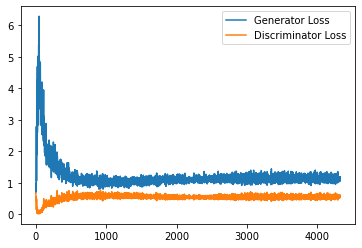

Step 87000: Generator loss: 1.1291892857551575, discriminator loss: 0.5612082859873772


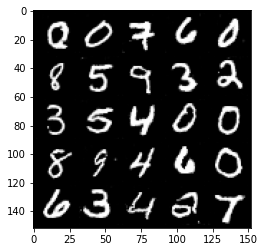

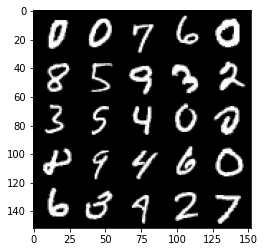

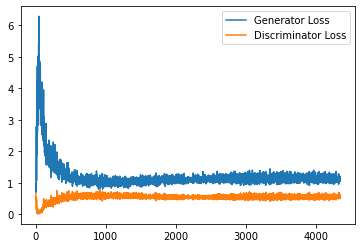

Step 87500: Generator loss: 1.1120185180902482, discriminator loss: 0.5633102300167083


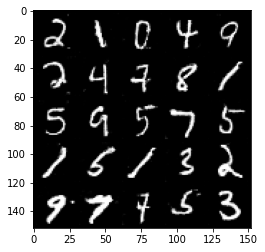

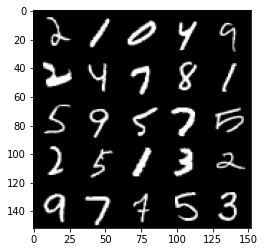

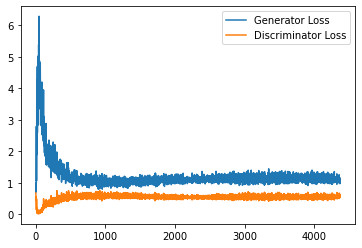

Step 88000: Generator loss: 1.1034278472661971, discriminator loss: 0.5639035591483116


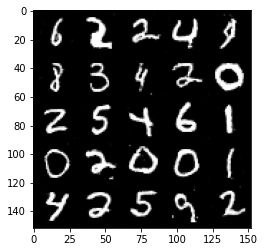

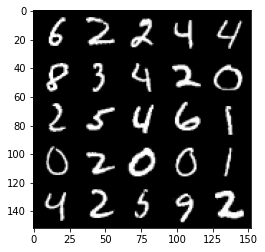

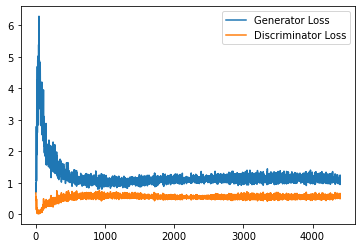

Step 88500: Generator loss: 1.1114168472290038, discriminator loss: 0.5642736203074455


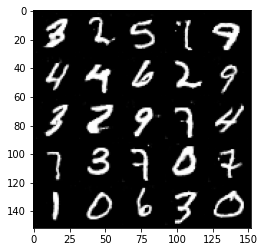

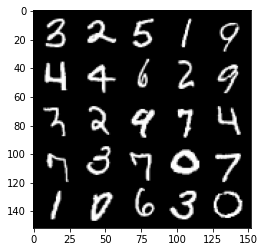

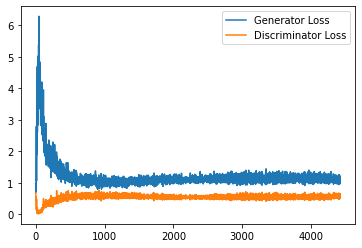

Step 89000: Generator loss: 1.1148862046003343, discriminator loss: 0.5640335549712181


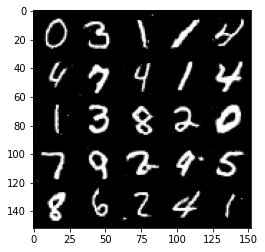

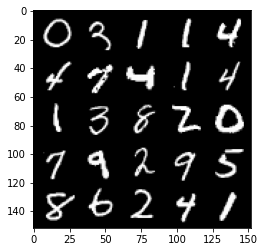

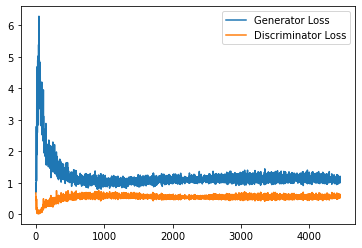

Step 89500: Generator loss: 1.1134033024311065, discriminator loss: 0.559986775815487


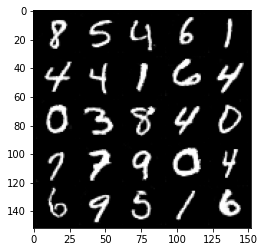

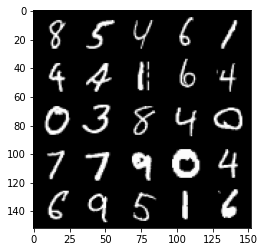

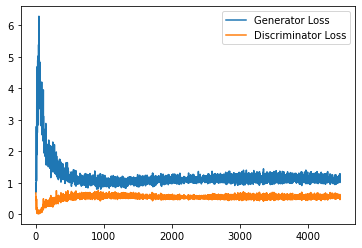

Step 90000: Generator loss: 1.129218193769455, discriminator loss: 0.5684113422036171


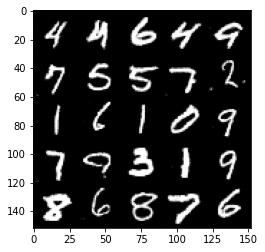

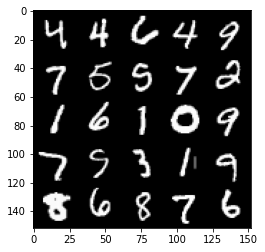

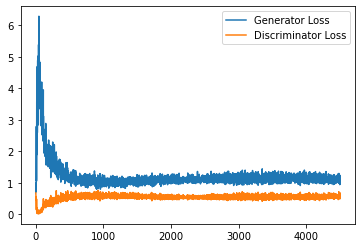

Step 90500: Generator loss: 1.132676029920578, discriminator loss: 0.5614647133946419


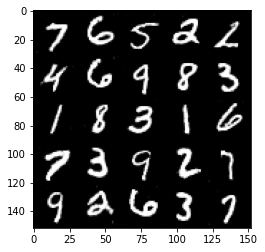

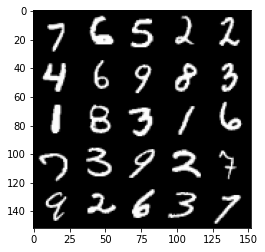

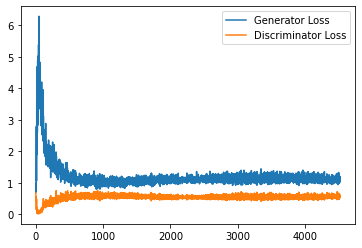

Step 91000: Generator loss: 1.10193516767025, discriminator loss: 0.5628233462572098


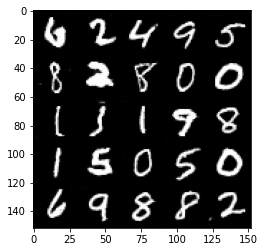

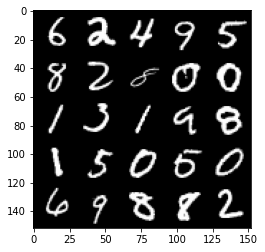

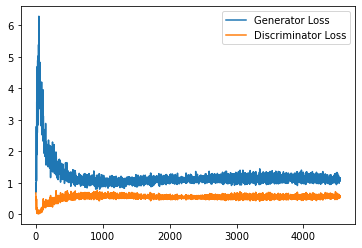

Step 91500: Generator loss: 1.1326194170713424, discriminator loss: 0.5666265466213226


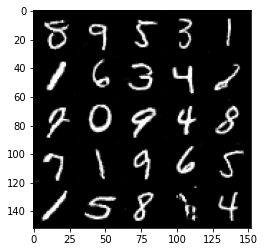

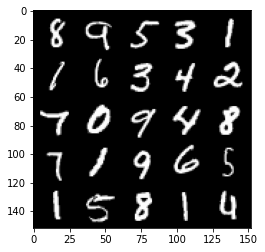

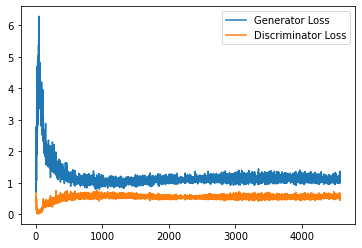

Step 92000: Generator loss: 1.125209611415863, discriminator loss: 0.5642375540137291


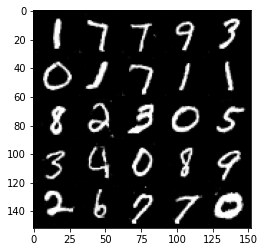

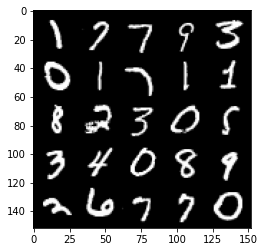

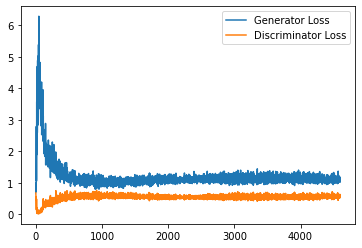

Step 92500: Generator loss: 1.126268296957016, discriminator loss: 0.5638478074073792


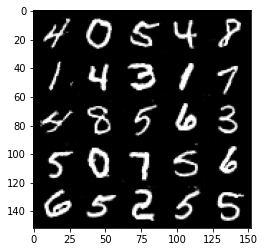

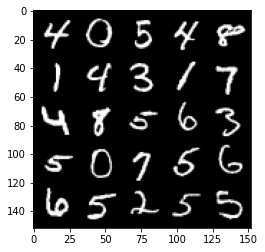

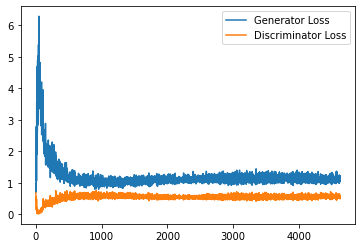

Step 93000: Generator loss: 1.1104955345392227, discriminator loss: 0.5708490890860558


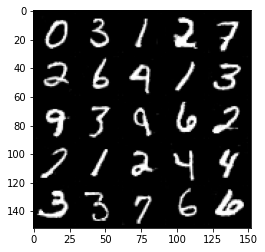

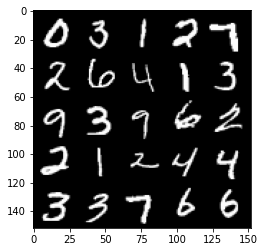

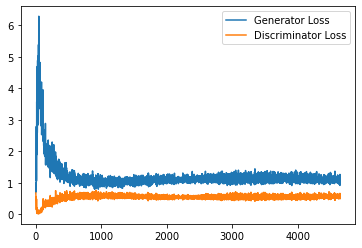

Step 93500: Generator loss: 1.129568863272667, discriminator loss: 0.5642078406214714


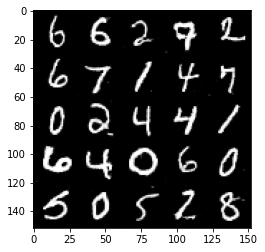

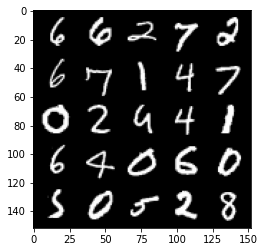

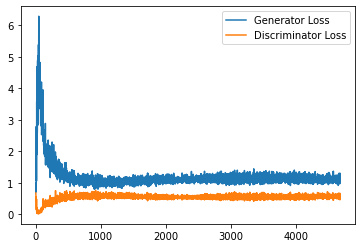

In [14]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

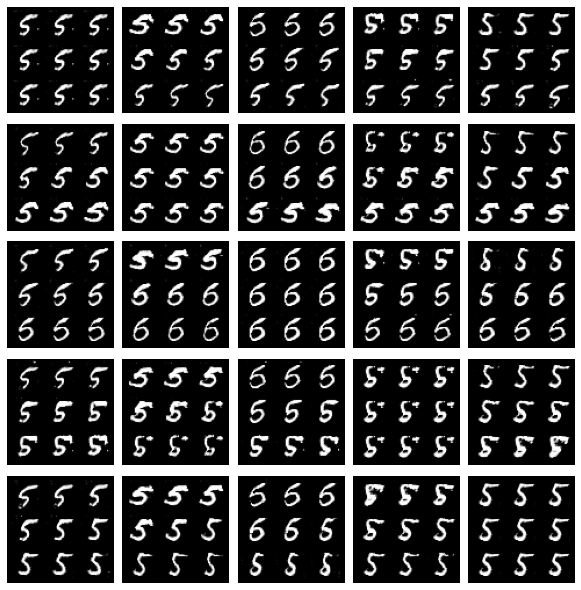

In [16]:
import math

n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()